In [1]:
import os
import cv2
import math
import glob
import shutil
import random
import itertools

import numpy as np
import pandas as pd

from tqdm import tqdm
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont

from Roots_point_detect_tool import *
from pattern_detection_tool import*

In [2]:
os_sys = '/root/notebooks/'

In [3]:
import os
import shutil

def remove_check_point(path):
    for file_name in os.listdir(path):
        #print(file_name)
        if 'checkpoints' in file_name:
            shutil.rmtree(os.path.join(path, file_name))

In [4]:
parent_folder_path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect'
remove_check_point(parent_folder_path)

for folder_name in tqdm(sorted(os.listdir(parent_folder_path)), total = len(os.listdir(parent_folder_path))):
    if os.path.isdir(os.path.join(parent_folder_path, folder_name)):
        remove_check_point(os.path.join(parent_folder_path, folder_name))
        print('Find {} files in [{}] folder'.format(len(os.listdir(os.path.join(parent_folder_path, folder_name))),folder_name))

 17%|█▋        | 4/23 [00:00<00:01, 16.72it/s]

Find 210 files in [1_o_image] folder
Find 210 files in [1_roots_unet_mask] folder
Find 210 files in [1_seg_image] folder
Find 826 files in [2_roots_unet_mask_components] folder


 26%|██▌       | 6/23 [00:00<00:01, 16.05it/s]

Find 479 files in [3_fill_up_tooth_by_root] folder
Find 479 files in [4_seg_img_with_cej] folder
Find 477 files in [5_draw_all_points_on_o_img] folder


100%|██████████| 23/23 [00:00<00:00, 34.50it/s]

Find 477 files in [5_draw_all_points_on_seg_img] folder
Find 477 files in [5_pattern_detection_result] folder
Find 477 files in [6_result_with_label] folder
Find 4 files in [__pycache__] folder
Find 4 files in [csv_file] folder
Find 2 files in [improve_test] folder
Find 7 files in [tooth_forward] folder


#### In 1_ is 
- 1.Original image.
- 2.Unet find root image.
- 3.Unet 3 class segmentation.

#### In 2_ is 
- 1.Split all color block in root image to image_name_x.
- 2.So one image would become many images.

#### In 3_ 826-469=357 
- 1.If 2_ non_zero pixel < 5000 or abs(slope(moment of inertia)) < 1.5 would filter out.
- 2.Filled up the remaining image by it's moment of inertia scale by it's hight and width.
- 3.Using segmentaiton tooth class (green pixel) to be mask to modify the over area filled up tooth.

#### In 4_ paste the 2_ image in segmentation image  
- 1.If 2_ non_zero pixel < 5000 or abs(slope(moment of inertia)) < 1.5 would filter out.
- 2.The remaining root would be paste on segmentation image

#### In 5_ using 

In [5]:
Match_result_csv_path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/csv_file/PBL_match_result.csv'
Match_result_csv = pd.read_csv(Match_result_csv_path)

In [6]:
def write_info_on_image(image_path,tabel,save_path):
    image_name = get_name_from_path(image_path,True)
    image_name_False = get_name_from_path(image_path,False)
    #print(image_name)
    image = Image.open(image_path)
    draw = ImageDraw.Draw(image)
    font = ImageFont.truetype('Roboto-Bold.ttf', size=35)
    (x, y) = (20, 10)
    error_ = False
    error_value = None
    if not tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name))].empty:
        tooth_name = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name))]['PBL_predict_tooth'].values[0].split('_')[0]
        #print(tooth_name)
        try:
            LPBL = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['PBL_value'].values[0]
            L_predict_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['PBL_stage'].values[0]
            L_Label_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_L'.format(tooth_name)]))]['state'].values[0]
        except:
            LPBL = -888
            L_predict_stage = -888
            L_Label_stage = -888
            
        try:
            RPBL = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['PBL_value'].values[0]
            R_predict_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['PBL_stage'].values[0]
            R_Label_stage = tabel.loc[(tabel['tooth_path'] == '{}'.format(image_name)) & (tabel['PBL_predict_tooth'].isin(['{}_R'.format(tooth_name)]))]['state'].values[0]
        except:
            RPBL = -888
            R_predict_stage = -888
            R_Label_stage = -888
        #print(L_predict_stage,R_predict_stage,L_Label_stage,R_Label_stage)
        if L_predict_stage != L_Label_stage or R_predict_stage != R_Label_stage:
            error_ = True
          
            if L_predict_stage == -999 and L_Label_stage != -999:
                error_value = 11##human can find model can't
            elif R_predict_stage == -999 and R_Label_stage != -999:
                error_value = 12##human can find model can't
            elif L_predict_stage == -999 and L_Label_stage != -999 and R_predict_stage == -999 and R_Label_stage != -999:
                error_value = 1##human can find model can't
            elif L_predict_stage != -999 and L_Label_stage == -999:
                error_value = 21##model can find human can't
            elif R_predict_stage != -999 and R_Label_stage == -999:
                error_value = 22##model can find human can't
            elif L_predict_stage != -999 and L_Label_stage == -999 and R_predict_stage != -999 and R_Label_stage == -999:
                error_value = 2##model can find human can't
            elif L_predict_stage == -888 and L_Label_stage == -888:
                error_value = 31##one PBL = -888
            elif R_predict_stage == -888 and R_Label_stage == -888:
                error_value = 32##one PBL = -888
            elif L_predict_stage == -888 and L_Label_stage == -888 and R_predict_stage == -888 and R_Label_stage == -888:
                error_value = 3##one PBL = -888
            elif L_predict_stage != -999 and L_predict_stage != -888 and L_Label_stage != -999 and L_Label_stage != -888:
                error_value = 0##error_value            
            elif R_predict_stage != -999 and R_predict_stage != -888 and R_Label_stage != -999 and R_Label_stage != -888:
                error_value = 0##error_value            
            elif L_predict_stage != -999 and L_predict_stage != -888 and L_Label_stage != -999 and L_Label_stage != -888 and R_predict_stage != -999 and R_predict_stage != -888 and R_Label_stage != -999 and R_Label_stage != -888:
                error_value = 0##error_value  
            else:
                print('class error!!!')
                print(L_predict_stage,L_Label_stage,R_predict_stage,R_Label_stage)
        message = "LPBL:{}% P_S:{} L_S:{}\nRPBL:{}% P_S:{} L_S:{}".format(round(LPBL,2),int(L_predict_stage),int(L_Label_stage),round(RPBL,2),int(R_predict_stage),int(R_Label_stage))
        color = 'rgb(255, 0, 0)'
        draw.text((x, y), message, fill=color, font=font)
    else:
        pass
    if error_:
        #print(error_value)
        if error_value ==0:
            image.save(os.path.join(save_path,image_name_False+'_err00.PNG'))
        elif error_value ==1:
            image.save(os.path.join(save_path,image_name_False+'_err10.PNG'))
        elif error_value ==11:
            image.save(os.path.join(save_path,image_name_False+'_err11.PNG'))
        elif error_value ==12:
            image.save(os.path.join(save_path,image_name_False+'_err12.PNG'))
        elif error_value ==2:
            image.save(os.path.join(save_path,image_name_False+'_err20.PNG'))
        elif error_value ==21:
            image.save(os.path.join(save_path,image_name_False+'_err21.PNG'))
        elif error_value ==22:
            image.save(os.path.join(save_path,image_name_False+'_err22.PNG'))
        elif error_value ==3:
            image.save(os.path.join(save_path,image_name_False+'_err30.PNG'))
        elif error_value ==31:
            image.save(os.path.join(save_path,image_name_False+'_err31.PNG'))
        elif error_value ==32:
            image.save(os.path.join(save_path,image_name_False+'_err32.PNG'))
        else:
            print('error_value error')
    else:
        image.save(os.path.join(save_path,image_name_False+'.PNG'))

In [7]:
#Write info of all detect result on image
path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/5_pattern_detection_result/*.PNG'
image_path_list = glob.glob(path)

save_path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label'

for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    write_info_on_image(image_path,Match_result_csv,save_path)

100%|██████████| 477/477 [01:05<00:00,  7.31it/s]


  0%|          | 0/477 [00:00<?, ?it/s]

NN_090903_154047_C07485
This case got unmatch predict and label


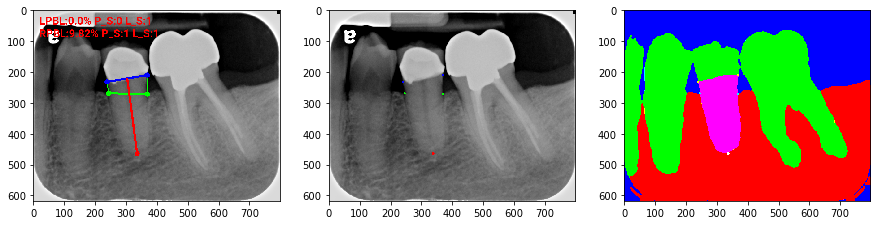

  1%|          | 5/477 [00:00<00:43, 10.89it/s]

NN_090903_154047_C07485
This case got unmatch predict and label


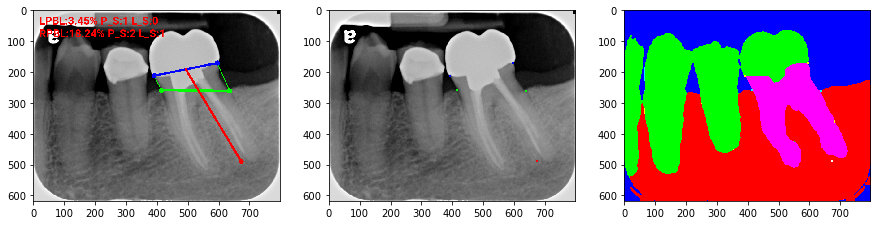

  1%|▏         | 7/477 [00:00<00:59,  7.95it/s]

NN_090903_154103_C07484
This case got unmatch predict and label


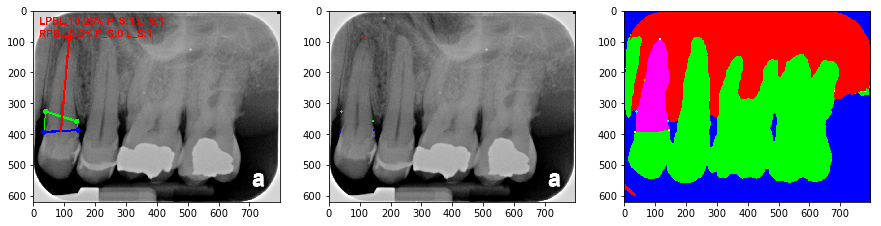

  4%|▍         | 18/477 [00:01<00:45, 10.09it/s]

NN_090903_154107_C07493
This case got unmatch predict and label


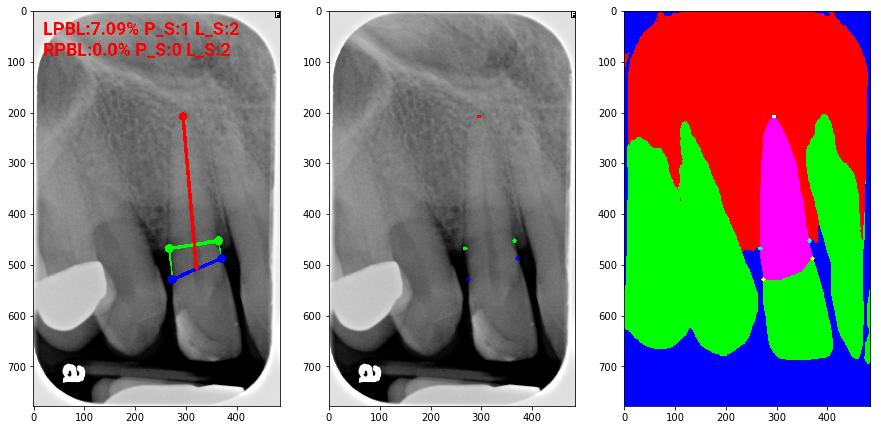

  5%|▍         | 22/477 [00:01<00:45, 10.00it/s]

NN_090903_154109_C07490
This case got unmatch predict and label


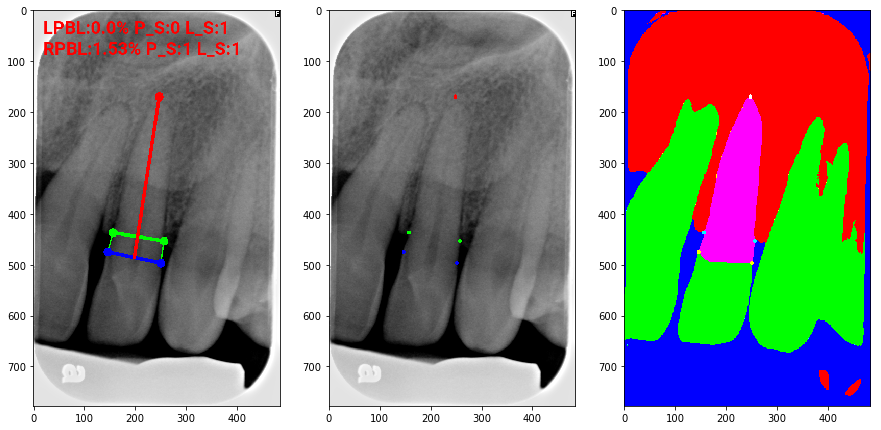

  5%|▌         | 24/477 [00:02<00:59,  7.61it/s]

NN_090903_154125_C0748A
This case got unmatch predict and label


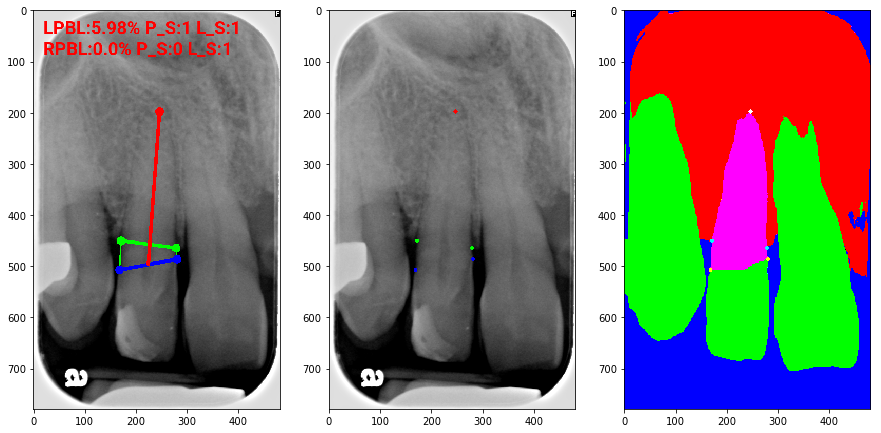

  6%|▌         | 29/477 [00:02<00:54,  8.24it/s]

NN_090903_154135_C0748B
This case got unmatch predict and label


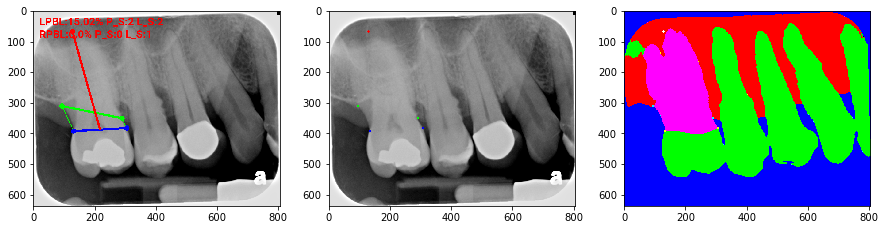

  7%|▋         | 35/477 [00:02<00:45,  9.64it/s]

NN_090903_154135_C0748B
This case got unmatch predict and label


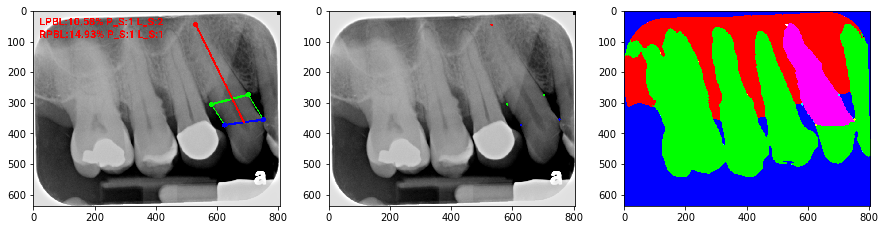

  8%|▊         | 38/477 [00:03<00:54,  8.00it/s]

NN_090903_154135_C0748B
This case got unmatch predict and label


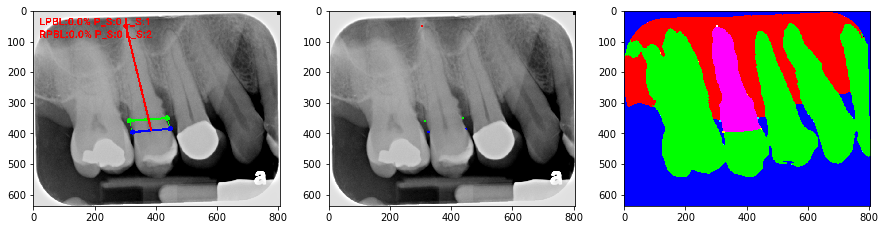

  8%|▊         | 39/477 [00:03<01:28,  4.96it/s]

NN_090903_154149_C0748C
This case got unmatch predict and label


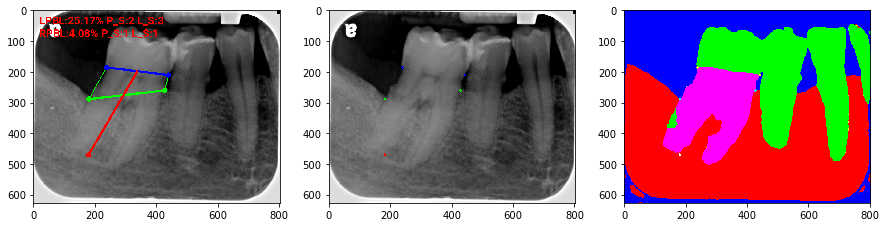

  8%|▊         | 40/477 [00:04<01:50,  3.95it/s]

NN_090903_154149_C0748C
This case got unmatch predict and label


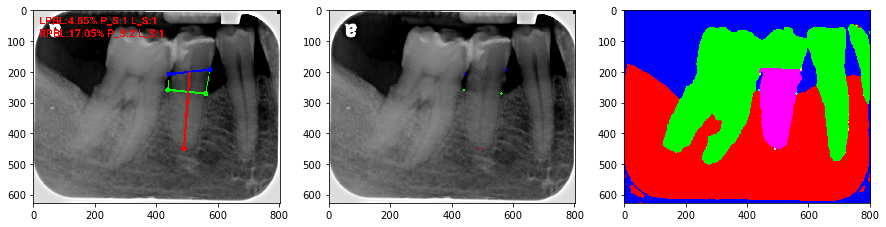

  9%|▊         | 41/477 [00:04<02:16,  3.20it/s]

NN_090903_155505_C07487
This case got unmatch predict and label


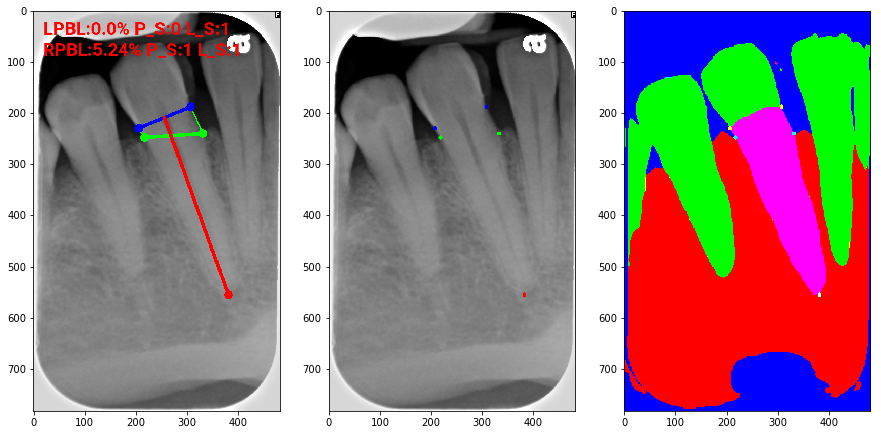

  9%|▉         | 44/477 [00:05<01:52,  3.85it/s]

NN_090903_155505_C07487
This case got unmatch predict and label


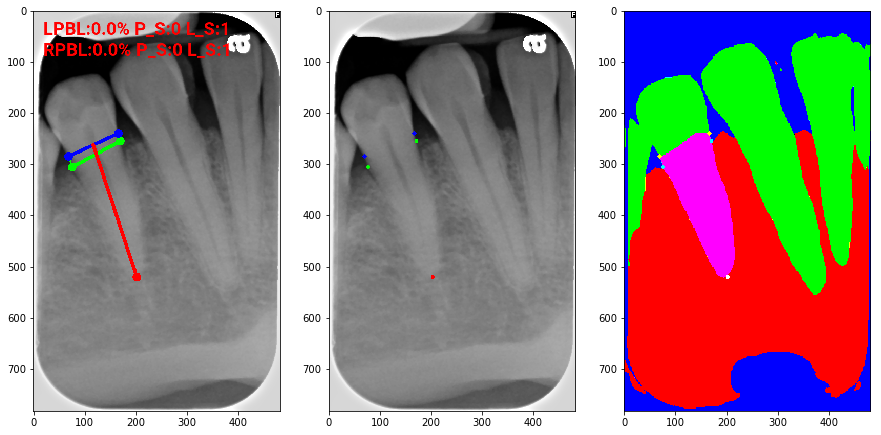

  9%|▉         | 45/477 [00:05<02:11,  3.30it/s]

NN_130821_101247_C057C1
This case got unmatch predict and label


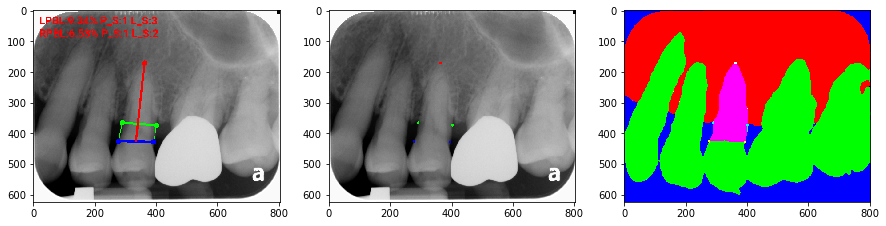

 11%|█         | 52/477 [00:05<01:38,  4.32it/s]

NN_130821_101247_C057C1
This case got unmatch predict and label


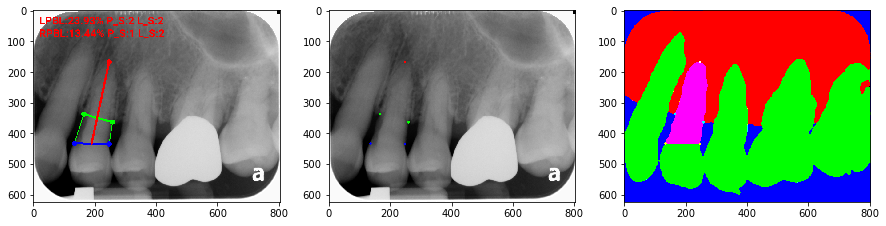

 11%|█         | 53/477 [00:06<02:01,  3.49it/s]

NN_130821_101303_C057BC
This case got unmatch predict and label


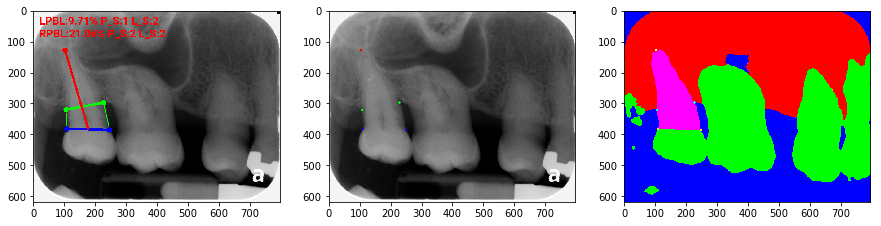

 12%|█▏        | 58/477 [00:06<01:34,  4.44it/s]

NN_130821_101344_C057B6
This case got unmatch predict and label


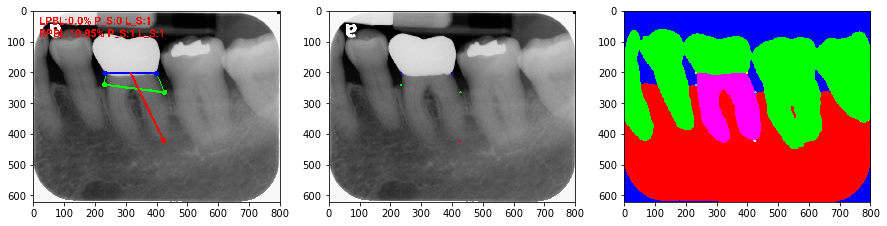

 13%|█▎        | 60/477 [00:07<01:35,  4.37it/s]

NN_130821_101344_C057B6
This case got unmatch predict and label


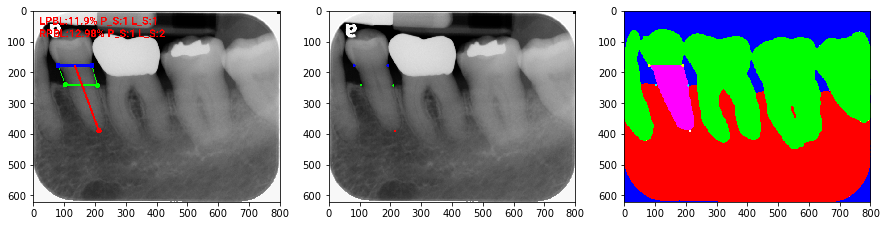

 13%|█▎        | 64/477 [00:07<01:18,  5.25it/s]

NN_130821_101425_C057C0
This case got unmatch predict and label


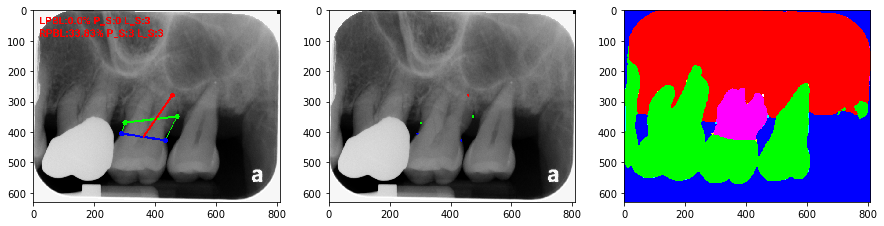

 14%|█▍        | 68/477 [00:08<01:07,  6.07it/s]

NN_130821_101425_C057C0
This case got unmatch predict and label


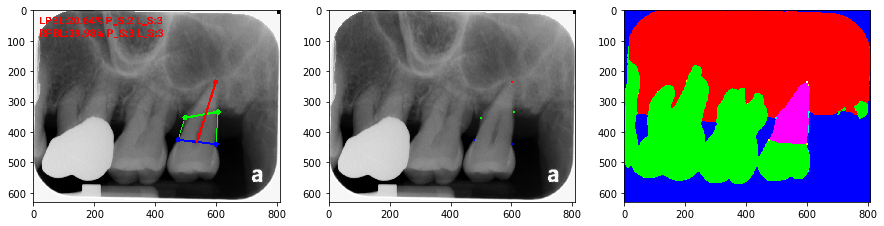

 14%|█▍        | 69/477 [00:08<01:34,  4.30it/s]

NN_130821_101454_C057BE
This case got unmatch predict and label


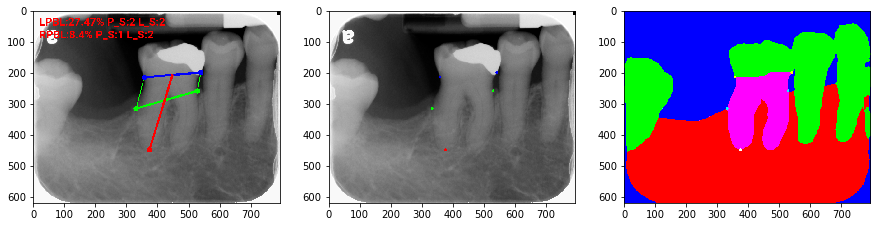

 15%|█▌        | 72/477 [00:08<01:21,  4.96it/s]

NN_130821_101454_C057BE
This case got unmatch predict and label


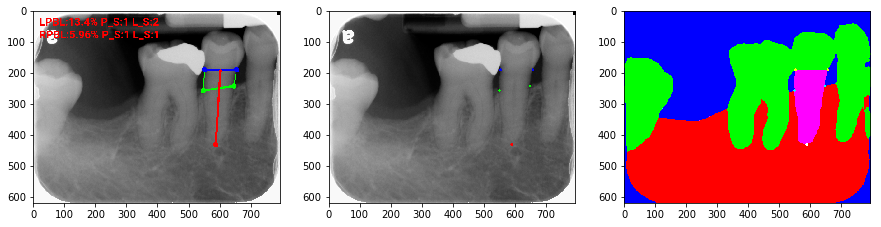

 16%|█▌        | 74/477 [00:09<01:25,  4.73it/s]

NN_130821_101502_C057B8
This case got unmatch predict and label


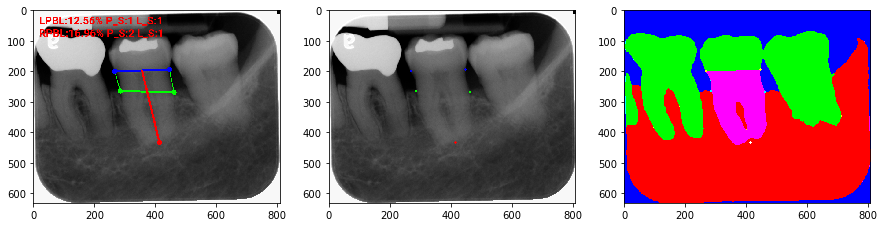

 16%|█▌        | 77/477 [00:09<01:15,  5.27it/s]

NN_151111_112018_C0ADD9
This case got unmatch predict and label


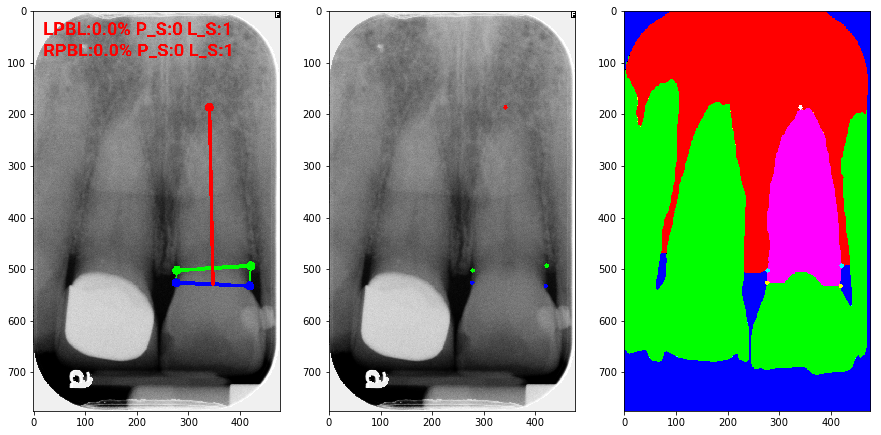

 18%|█▊        | 84/477 [00:10<00:59,  6.58it/s]

NN_151111_112020_C0ADDC
This case got unmatch predict and label


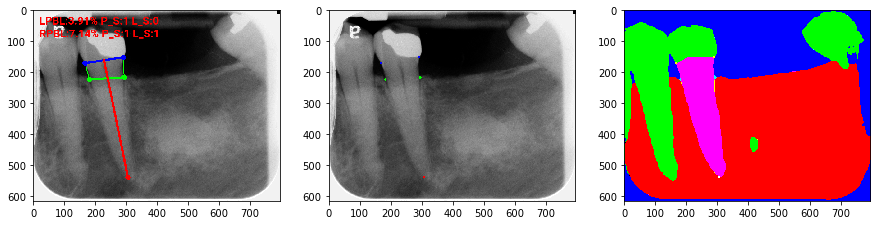

 18%|█▊        | 87/477 [00:10<00:57,  6.84it/s]

NN_151111_112023_C0ADD5
This case got unmatch predict and label


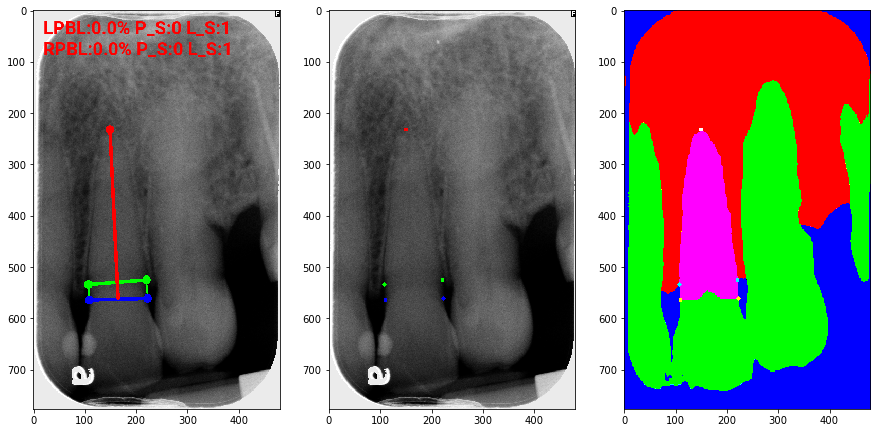

 18%|█▊        | 88/477 [00:11<01:32,  4.23it/s]

NN_151111_112023_C0ADD5
This case got unmatch predict and label


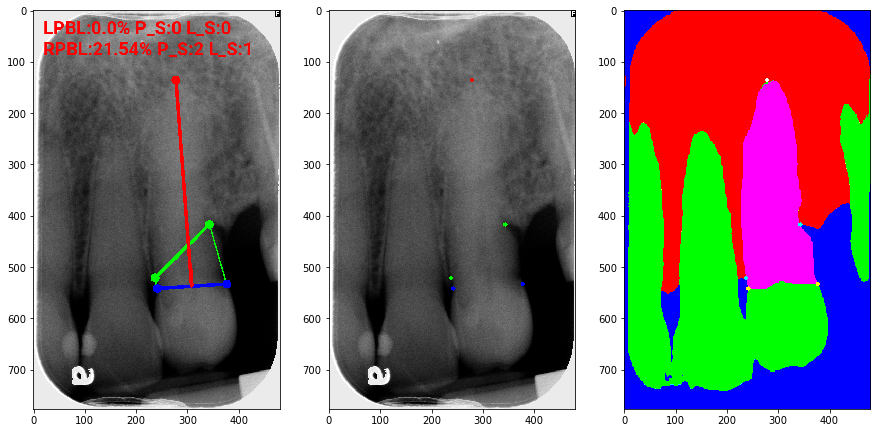

 19%|█▉        | 90/477 [00:11<01:30,  4.28it/s]

NN_151111_112125_C0ADD7
This case got unmatch predict and label


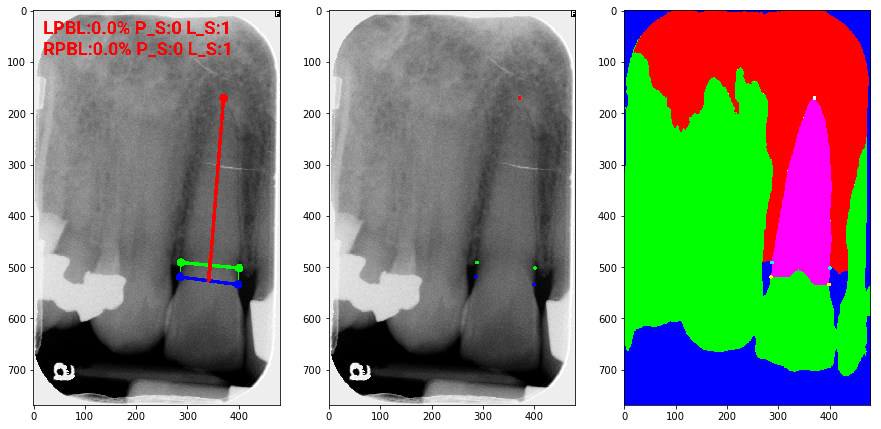

 21%|██        | 101/477 [00:11<01:06,  5.69it/s]

NN_151111_112208_C0ADD1
This case got unmatch predict and label


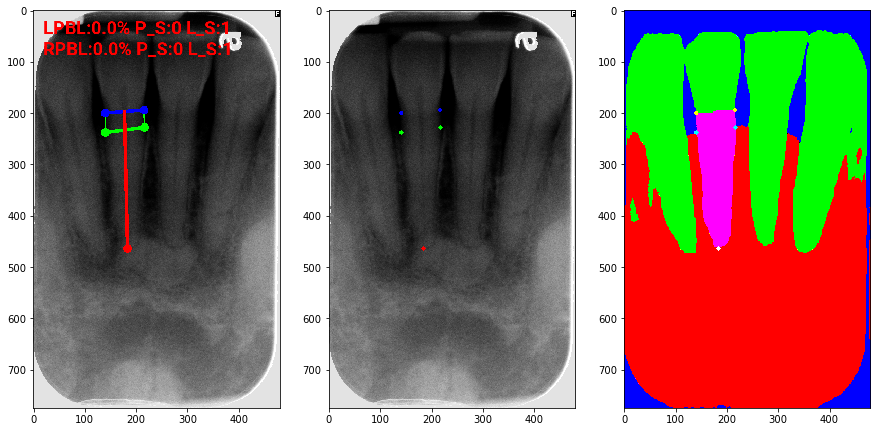

 22%|██▏       | 104/477 [00:12<01:05,  5.72it/s]

NN_151111_112209_C0ADDD
This case got unmatch predict and label


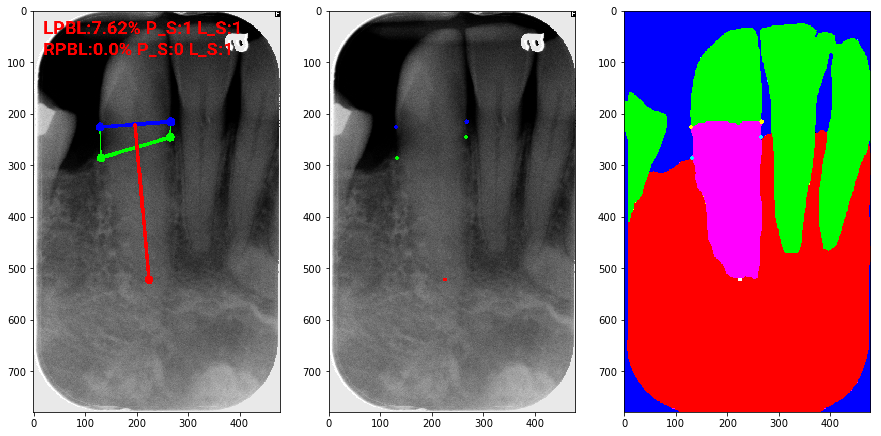

 22%|██▏       | 107/477 [00:12<01:02,  5.96it/s]

NN_151111_112215_C0ADD8
This case got unmatch predict and label


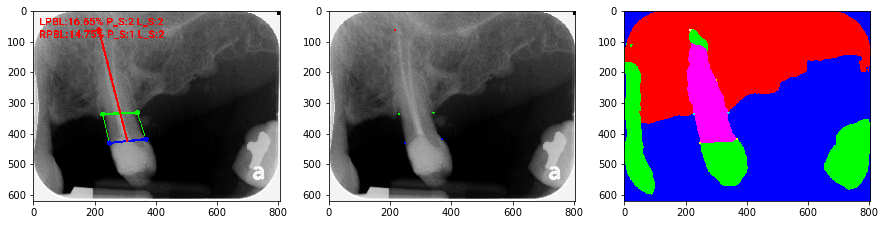

 23%|██▎       | 109/477 [00:13<01:07,  5.46it/s]

NN_160212_152828_9C3C64
This case got unmatch predict and label


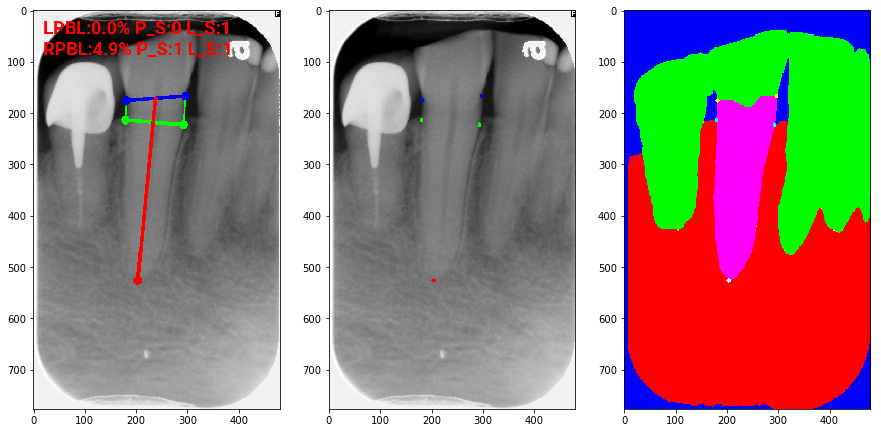

 24%|██▍       | 116/477 [00:13<00:53,  6.69it/s]

NN_160212_152831_9C3C62
This case got unmatch predict and label


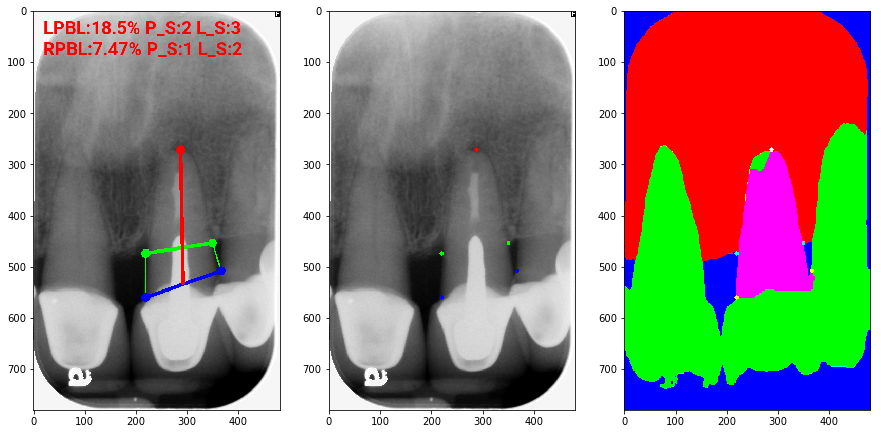

 25%|██▍       | 117/477 [00:14<01:30,  3.98it/s]

NN_160212_152834_9C3C65
This case got unmatch predict and label


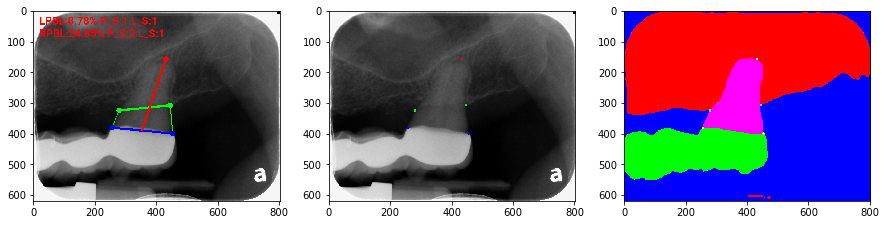

 25%|██▍       | 119/477 [00:14<01:25,  4.19it/s]

NN_160212_152928_9C3C74
This case got unmatch predict and label


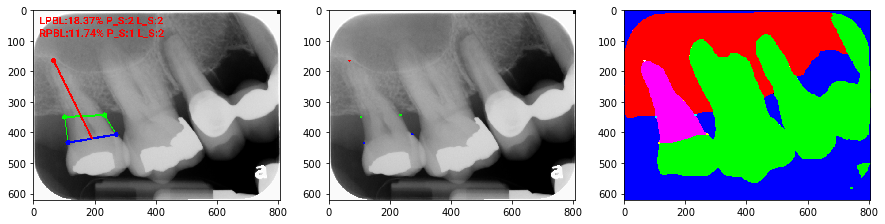

 28%|██▊       | 134/477 [00:15<00:59,  5.72it/s]

NN_160212_152928_9C3C74
This case got unmatch predict and label


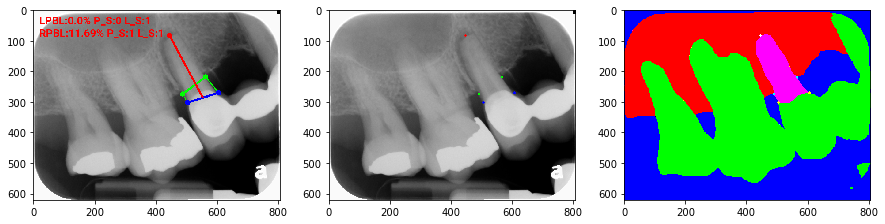

 29%|██▊       | 136/477 [00:15<01:02,  5.49it/s]

NN_160212_152938_9C3C6C
This case got unmatch predict and label


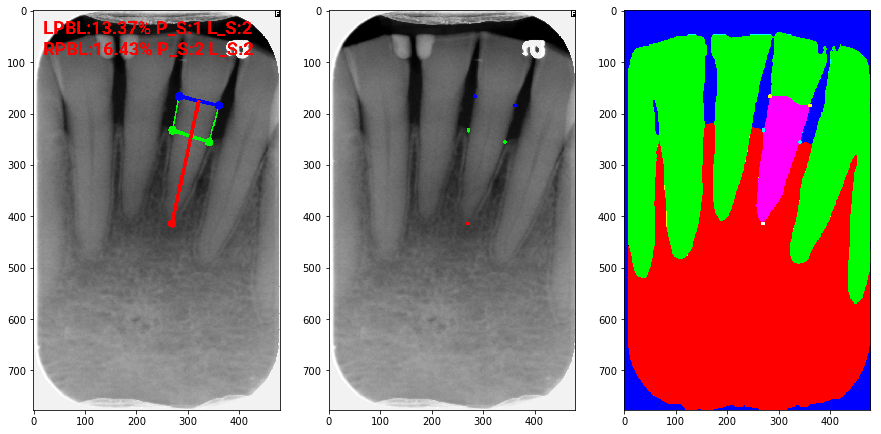

 30%|██▉       | 141/477 [00:15<00:51,  6.48it/s]

NN_160212_152938_9C3C6C
This case got unmatch predict and label


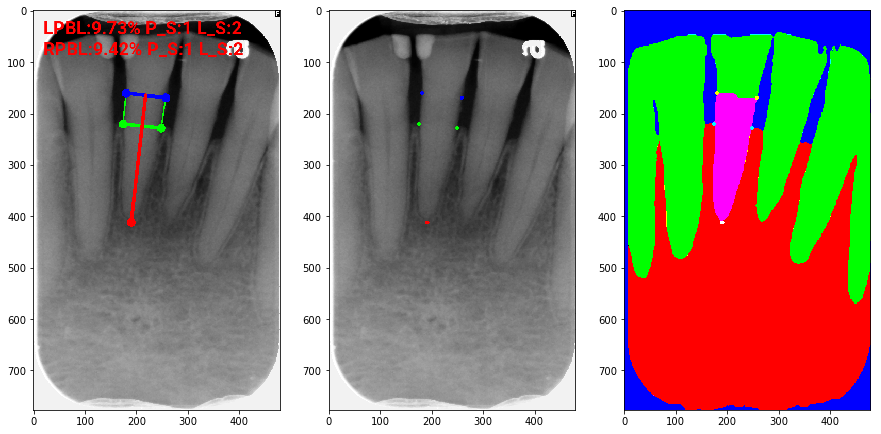

 30%|██▉       | 143/477 [00:16<00:56,  5.96it/s]

NN_160212_152945_9C3C68
This case got unmatch predict and label


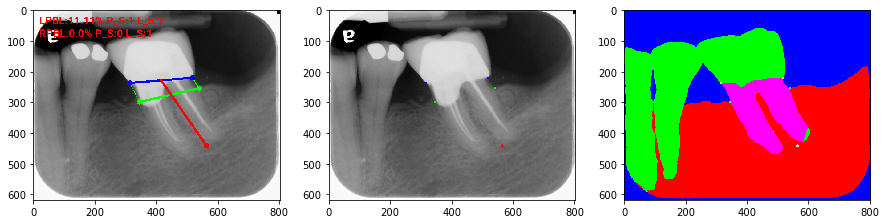

 31%|███       | 147/477 [00:16<00:49,  6.63it/s]

NN_160212_152957_9C3C6E
This case got unmatch predict and label


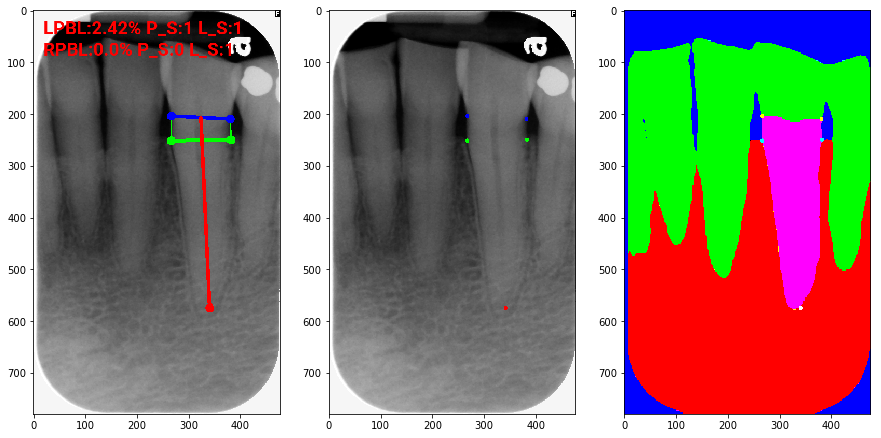

 31%|███       | 148/477 [00:17<01:19,  4.15it/s]

NN_160217_094541_16D98D
This case got unmatch predict and label


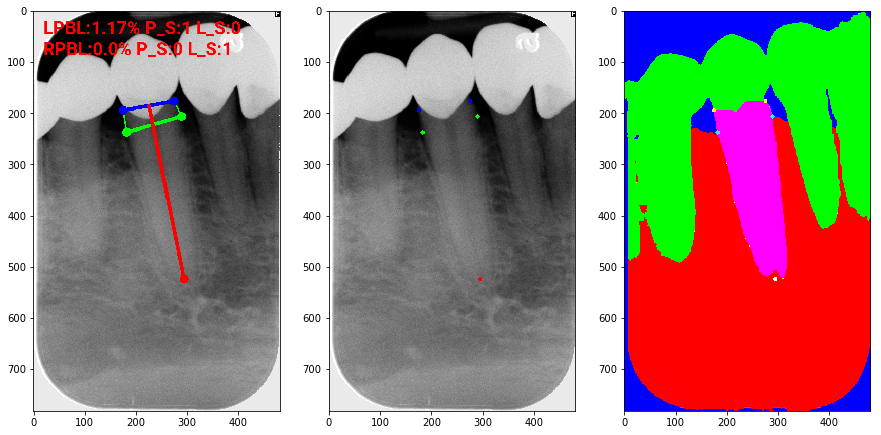

 33%|███▎      | 159/477 [00:17<00:57,  5.57it/s]

NN_160217_094546_16D990
This case got unmatch predict and label


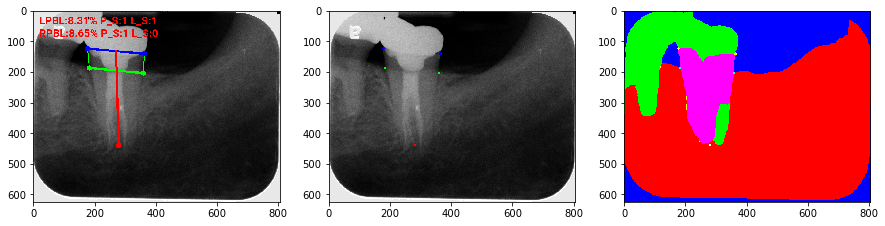

 34%|███▍      | 161/477 [00:18<00:57,  5.48it/s]

NN_160217_094550_16D995
This case got unmatch predict and label


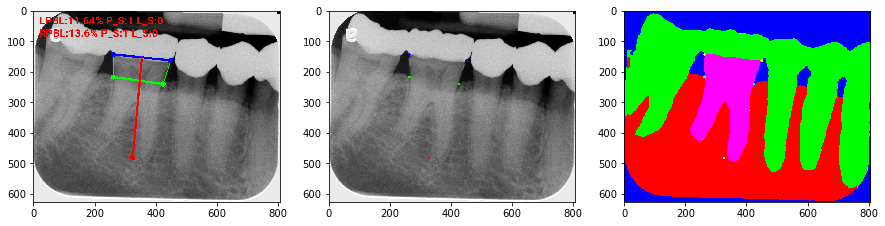

 35%|███▍      | 165/477 [00:18<00:50,  6.16it/s]

NN_160217_094625_16D996
This case got unmatch predict and label


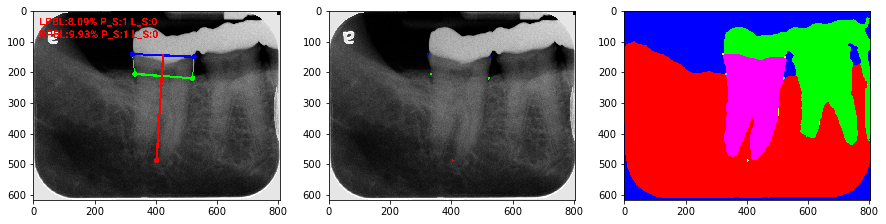

 38%|███▊      | 183/477 [00:18<00:35,  8.21it/s]

NN_160217_094625_16D996
This case got unmatch predict and label


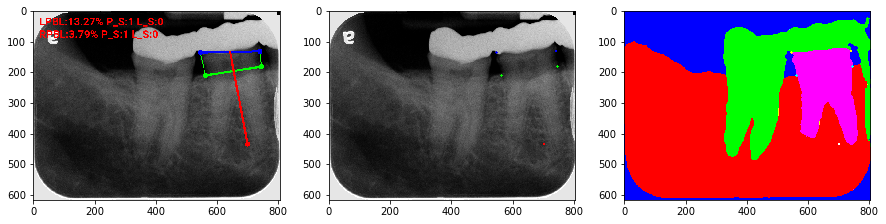

 39%|███▉      | 185/477 [00:19<00:41,  7.02it/s]

NN_160217_094646_16D997
This case got unmatch predict and label


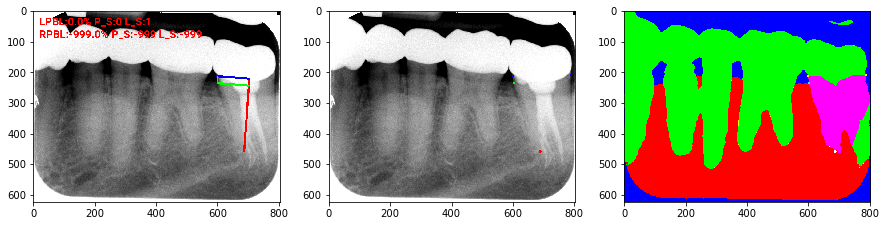

 40%|████      | 191/477 [00:19<00:33,  8.49it/s]

NN_160217_094646_16D997
This case got unmatch predict and label


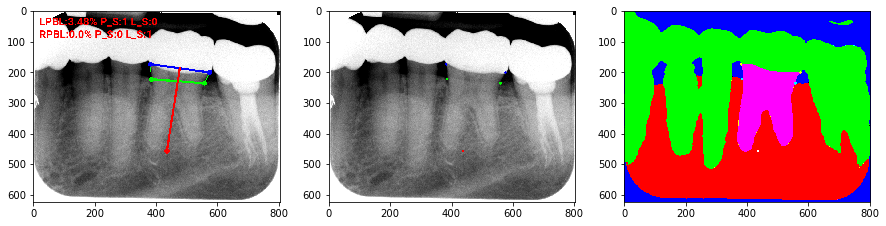

 40%|████      | 193/477 [00:20<00:40,  7.01it/s]

NN_160217_094646_16D997
This case got unmatch predict and label


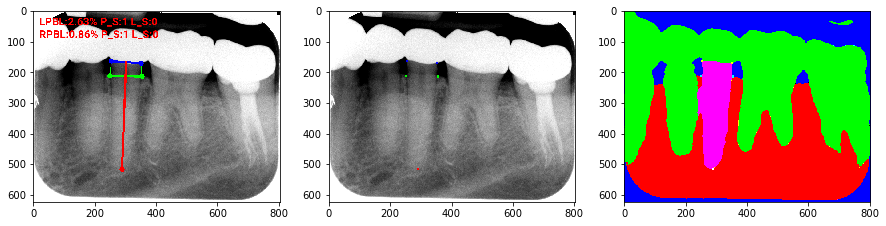

 41%|████      | 195/477 [00:20<00:45,  6.21it/s]

NN_161012_105949_C03836
This case got unmatch predict and label


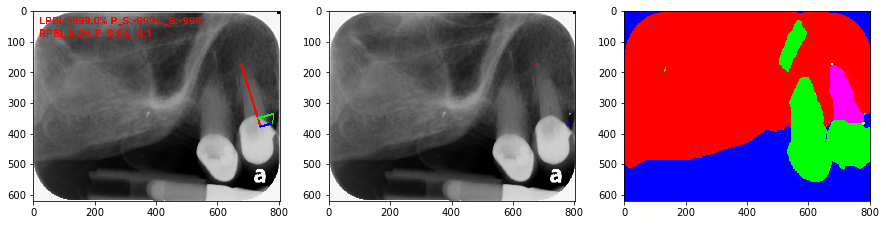

 42%|████▏     | 200/477 [00:20<00:37,  7.43it/s]

NN_161012_105949_C03836
This case got unmatch predict and label


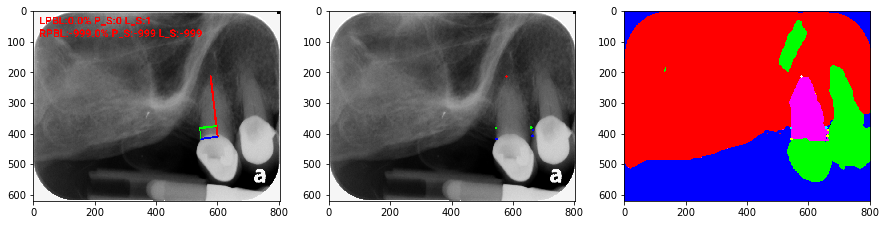

 42%|████▏     | 202/477 [00:21<00:43,  6.25it/s]

NN_161012_110008_C0382F
This case got unmatch predict and label


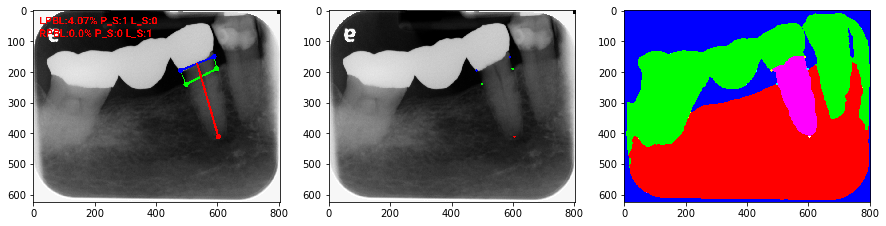

 44%|████▍     | 209/477 [00:21<00:34,  7.82it/s]

NN_161012_110024_C0383B
This case got unmatch predict and label


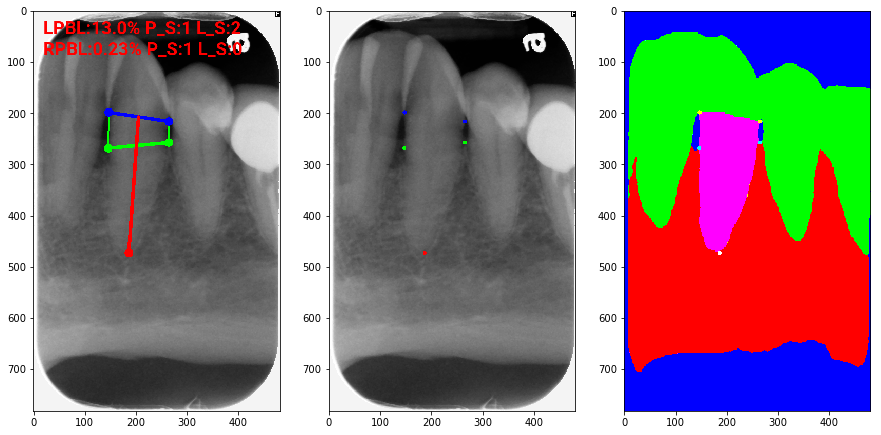

 45%|████▌     | 215/477 [00:22<00:29,  8.94it/s]

NN_161012_110059_C0383C
This case got unmatch predict and label


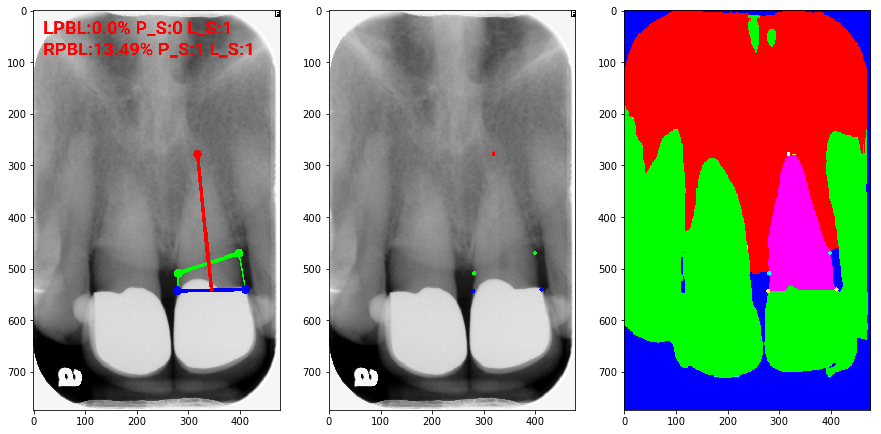

 46%|████▋     | 221/477 [00:22<00:25, 10.18it/s]

NN_161012_110111_C03830
This case got unmatch predict and label


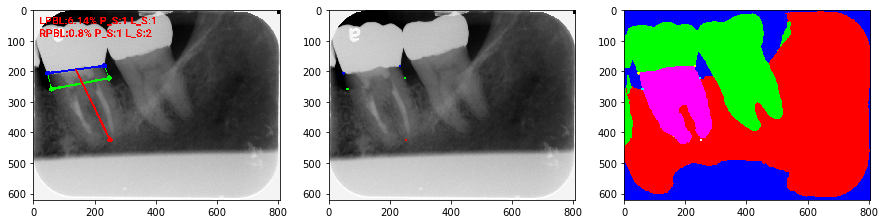

 47%|████▋     | 226/477 [00:22<00:22, 10.96it/s]

NN_161012_111730_C03831
This case got unmatch predict and label


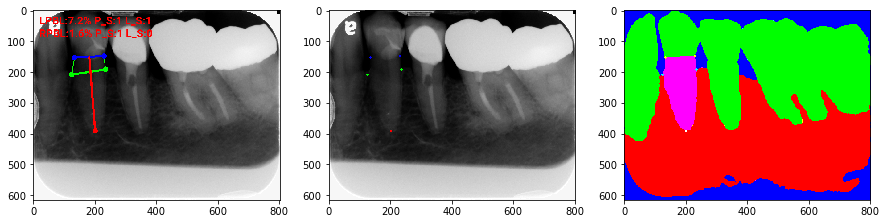

 48%|████▊     | 230/477 [00:23<00:23, 10.40it/s]

NN_170328_100548_9CADD7
This case got unmatch predict and label


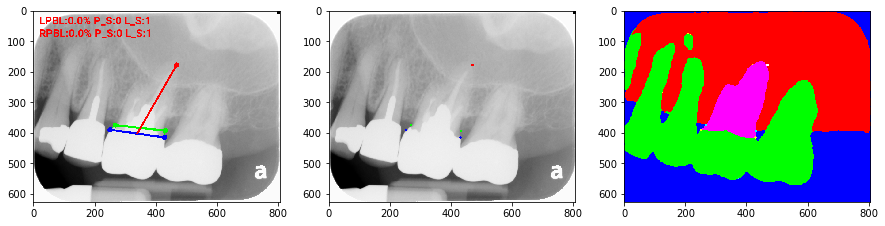

 49%|████▉     | 236/477 [00:23<00:20, 11.67it/s]

NN_170328_100548_9CADD7
This case got unmatch predict and label


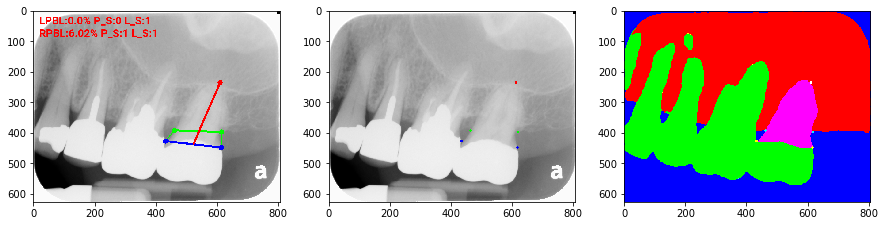

 50%|████▉     | 238/477 [00:24<00:27,  8.69it/s]

NN_170328_100548_9CADD7
This case got unmatch predict and label


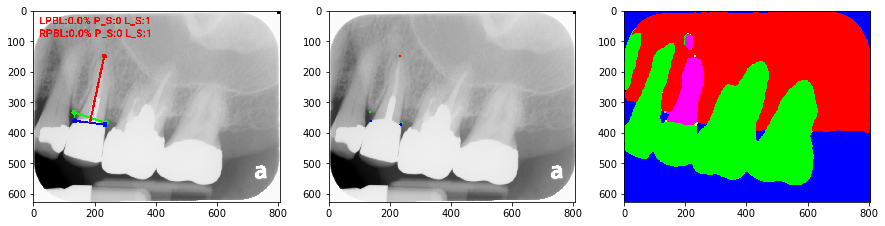

 50%|█████     | 240/477 [00:24<00:34,  6.88it/s]

NN_170328_100552_9CADD4
This case got unmatch predict and label


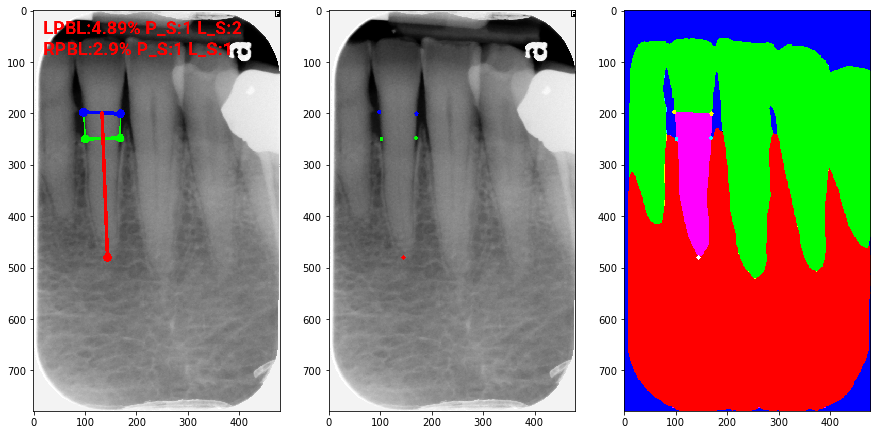

 51%|█████     | 241/477 [00:24<00:55,  4.27it/s]

NN_170328_100559_9CADD8
This case got unmatch predict and label


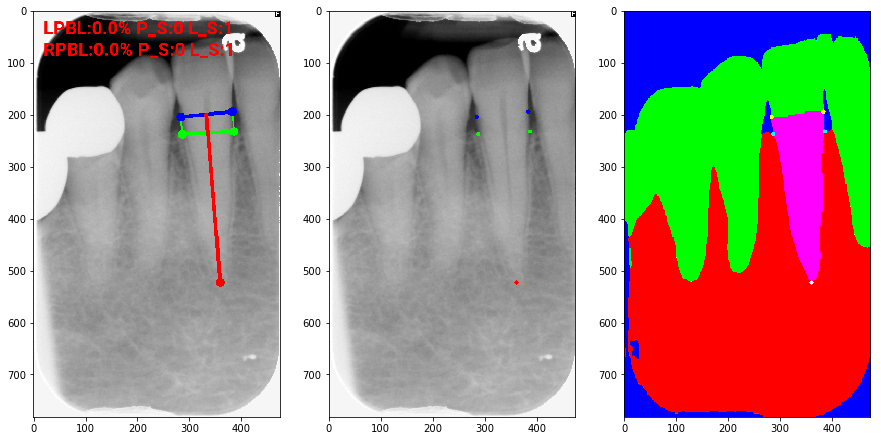

 52%|█████▏    | 247/477 [00:25<00:42,  5.38it/s]

NN_170328_100606_9CADE0
This case got unmatch predict and label


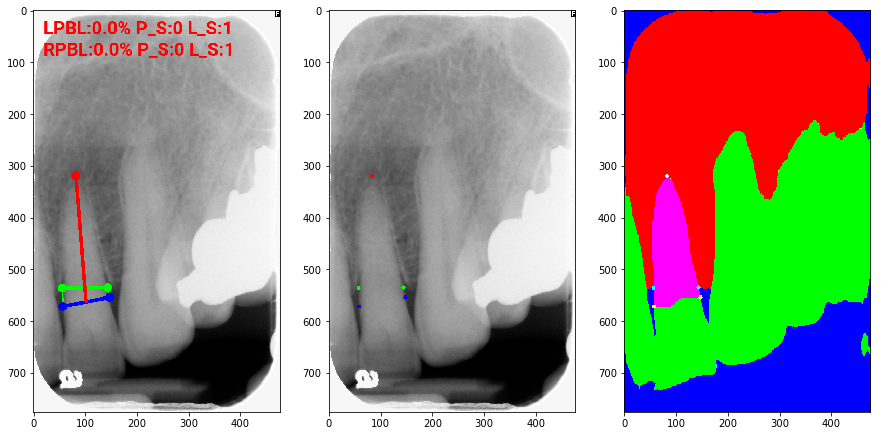

 52%|█████▏    | 249/477 [00:25<00:45,  5.06it/s]

NN_170328_100616_9CADD9
This case got unmatch predict and label


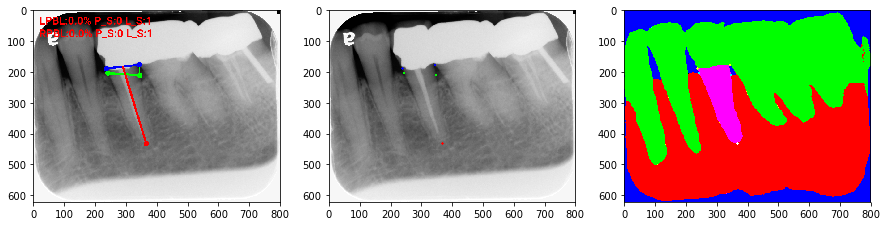

 53%|█████▎    | 253/477 [00:26<00:37,  5.95it/s]

NN_170328_100620_9CADDD
This case got unmatch predict and label


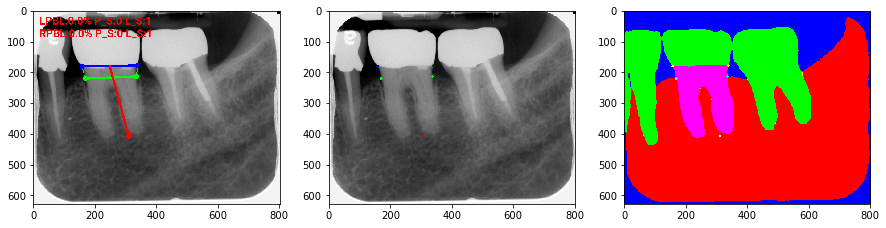

 54%|█████▎    | 256/477 [00:26<00:34,  6.48it/s]

NN_170328_100622_9CADDE
This case got unmatch predict and label


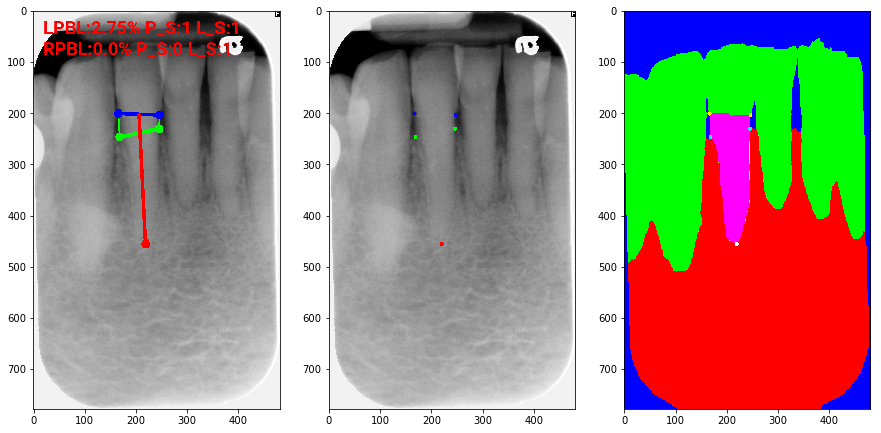

 55%|█████▍    | 261/477 [00:27<00:28,  7.49it/s]

NN_170328_100622_9CADDE
This case got unmatch predict and label


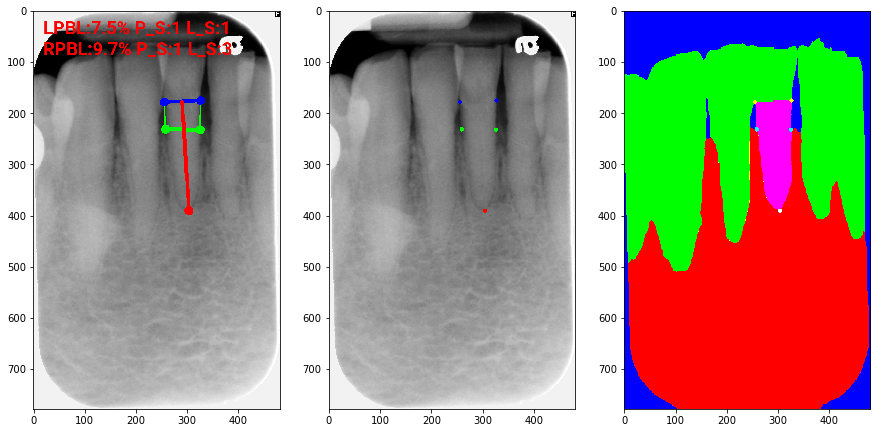

 55%|█████▍    | 262/477 [00:27<00:46,  4.60it/s]

NN_170328_100633_9CADDB
This case got unmatch predict and label


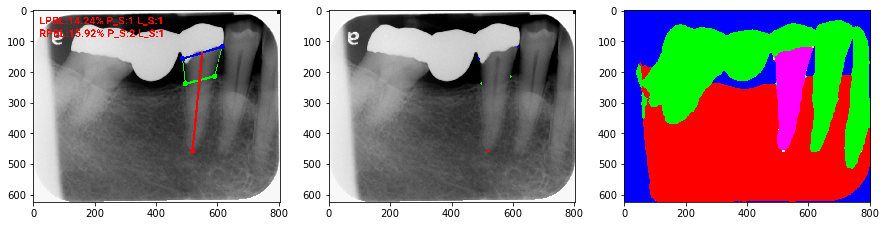

 56%|█████▋    | 269/477 [00:27<00:35,  5.86it/s]

NN_170328_100634_9CADD5
This case got unmatch predict and label


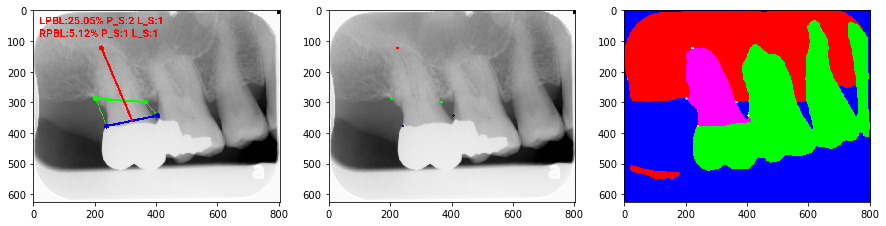

 57%|█████▋    | 270/477 [00:28<00:54,  3.78it/s]

NN_170328_100636_9CADE3
This case got unmatch predict and label


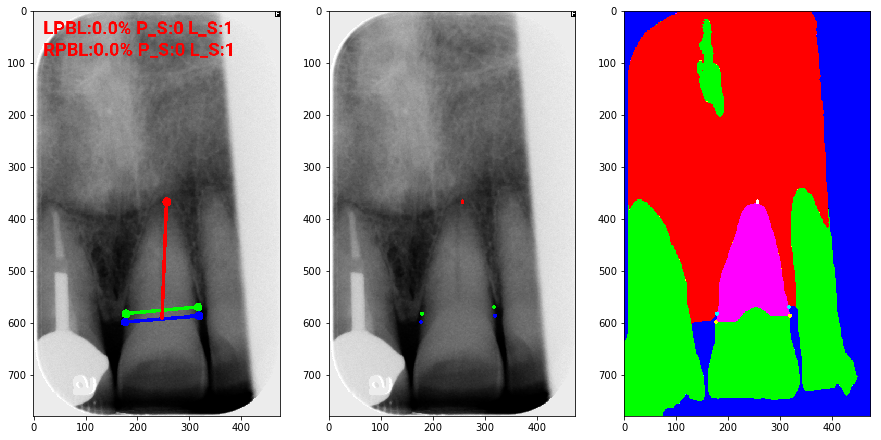

 57%|█████▋    | 274/477 [00:28<00:43,  4.63it/s]

NN_170328_100646_9CADDF
This case got unmatch predict and label


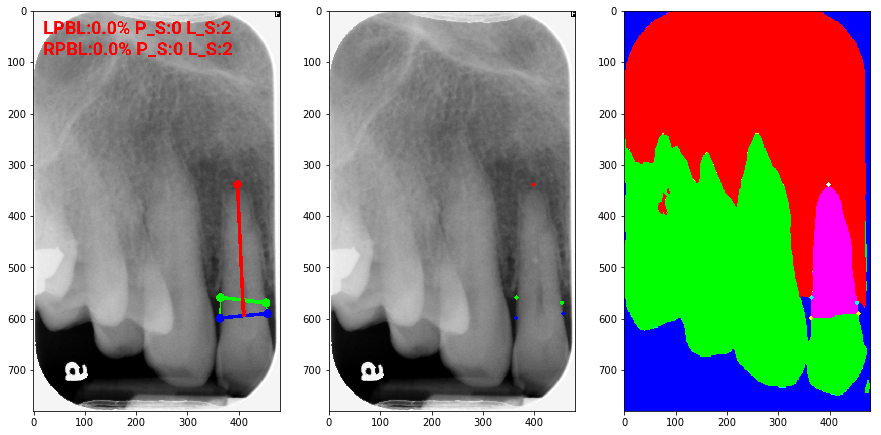

 58%|█████▊    | 277/477 [00:29<00:39,  5.06it/s]

NN_170328_100649_9CADE1
This case got unmatch predict and label


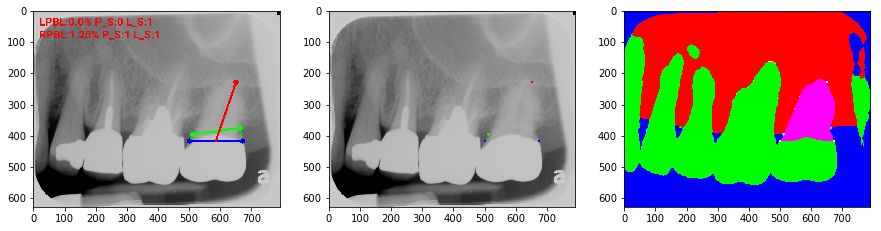

 59%|█████▉    | 281/477 [00:29<00:32,  5.96it/s]

NN_170328_100649_9CADE1
This case got unmatch predict and label


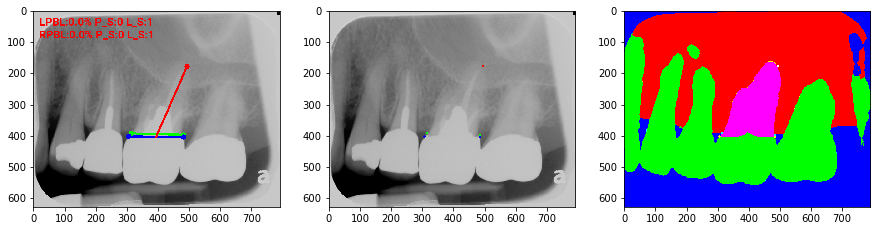

 59%|█████▉    | 282/477 [00:30<00:45,  4.27it/s]

NN_170328_100649_9CADE1
This case got unmatch predict and label


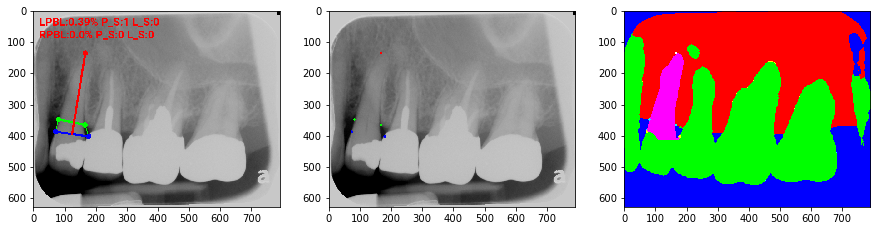

 60%|█████▉    | 284/477 [00:30<00:45,  4.26it/s]

NN_180620_110451_16FA06
This case got unmatch predict and label


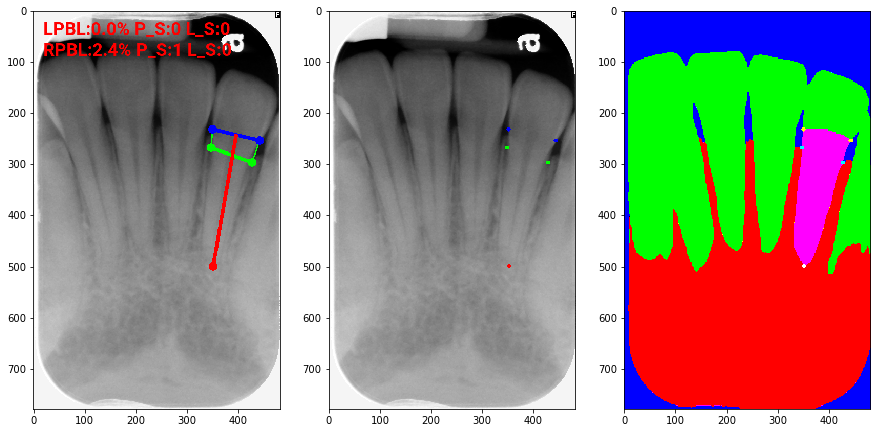

 60%|█████▉    | 285/477 [00:30<00:57,  3.32it/s]

NN_180620_110451_16FA06
This case got unmatch predict and label


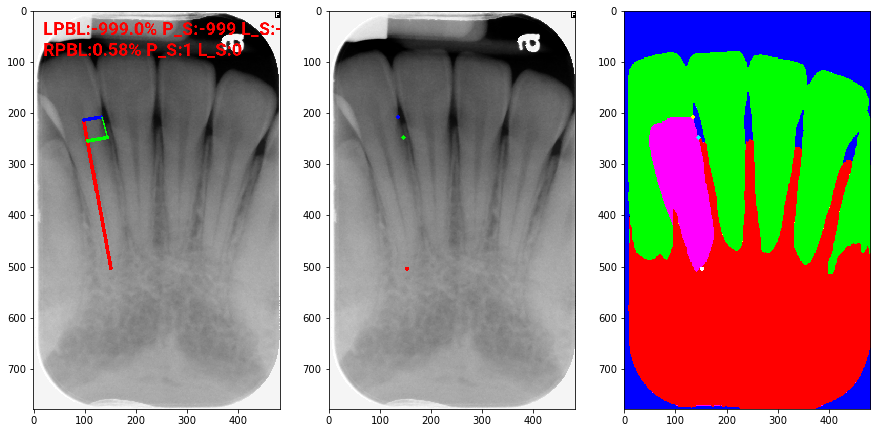

 60%|██████    | 288/477 [00:31<00:47,  3.97it/s]

NN_180620_110451_16FA06
This case got unmatch predict and label


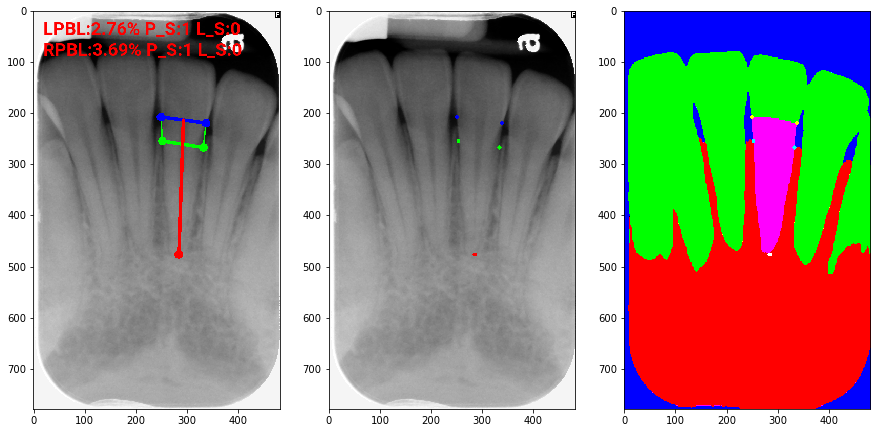

 61%|██████    | 289/477 [00:31<00:56,  3.35it/s]

NN_180620_110451_16FA06
This case got unmatch predict and label


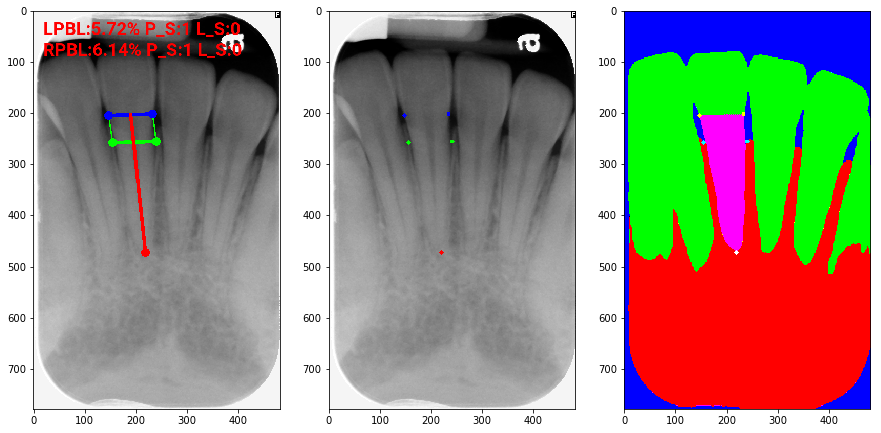

 61%|██████    | 290/477 [00:32<01:05,  2.84it/s]

NN_180620_110702_16FA12
This case got unmatch predict and label


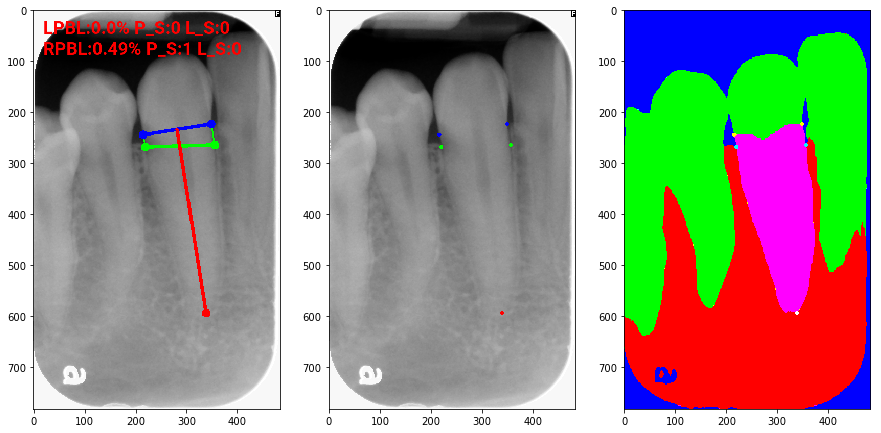

 66%|██████▋   | 317/477 [00:32<00:40,  3.97it/s]

NN_180620_110707_16FA0F
This case got unmatch predict and label


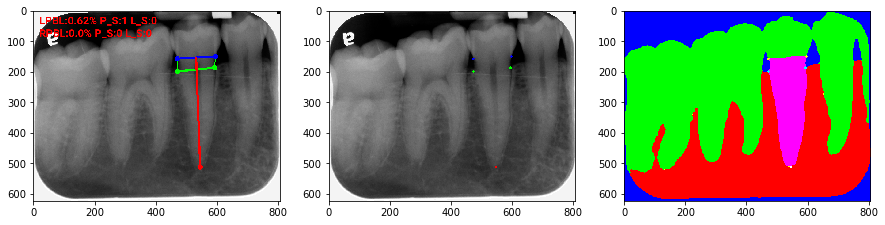

 67%|██████▋   | 321/477 [00:33<00:33,  4.63it/s]

NN_180620_113029_16FA04
This case got unmatch predict and label


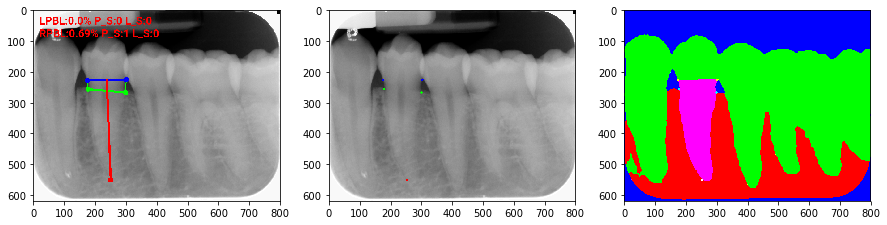

 69%|██████▉   | 330/477 [00:33<00:24,  6.08it/s]

NN_180719_084830_16F366
This case got unmatch predict and label


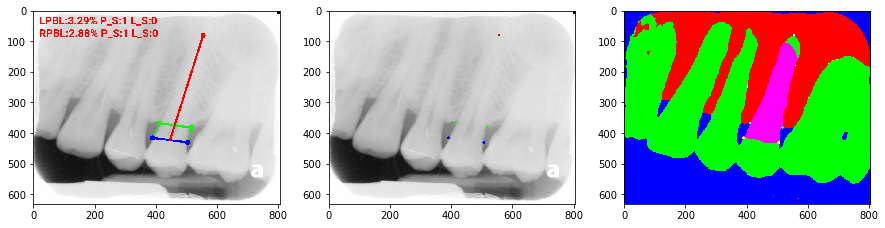

 73%|███████▎  | 348/477 [00:34<00:15,  8.25it/s]

NN_180719_084830_16F366
This case got unmatch predict and label


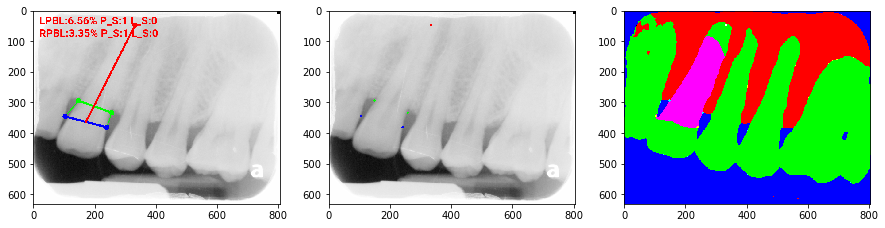

NN_180719_084830_16F366
This case got unmatch predict and label


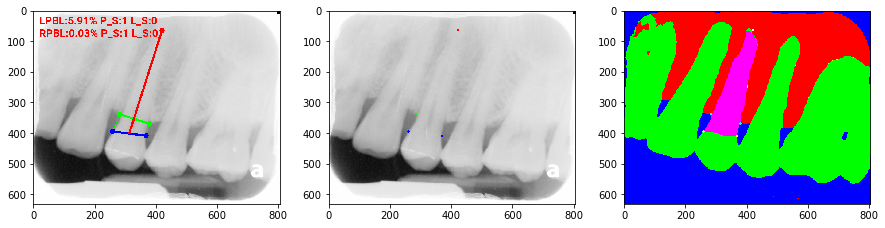

 74%|███████▎  | 351/477 [00:34<00:20,  6.14it/s]

NN_180719_084830_16F373
This case got unmatch predict and label


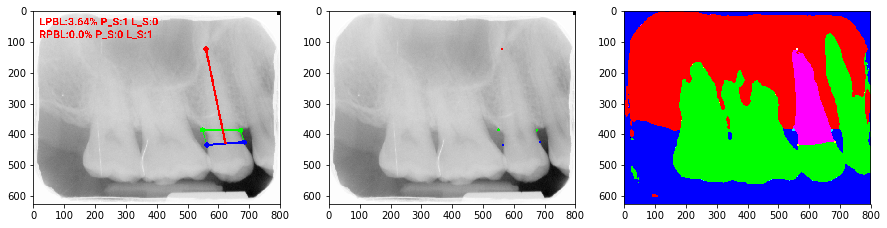

 74%|███████▍  | 354/477 [00:35<00:19,  6.33it/s]

NN_180719_084831_16F36A
This case got unmatch predict and label


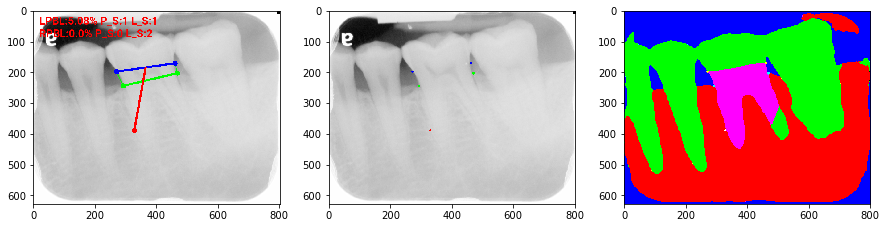

 75%|███████▍  | 356/477 [00:35<00:20,  5.76it/s]

NN_180719_084831_16F375
This case got unmatch predict and label


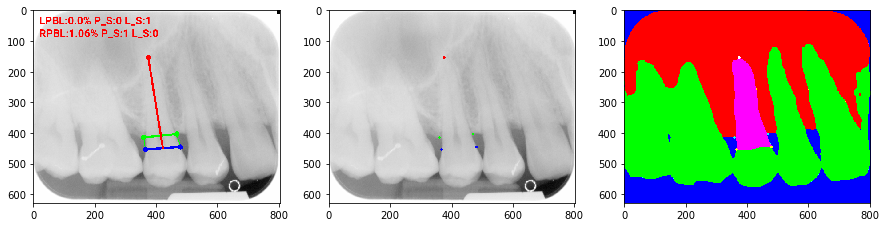

 75%|███████▌  | 359/477 [00:36<00:18,  6.34it/s]

NN_180719_084831_16F375
This case got unmatch predict and label


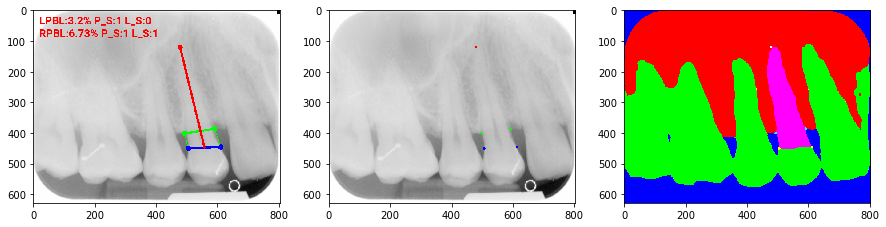

 76%|███████▌  | 361/477 [00:36<00:19,  5.99it/s]

NN_180719_084849_16F364
This case got unmatch predict and label


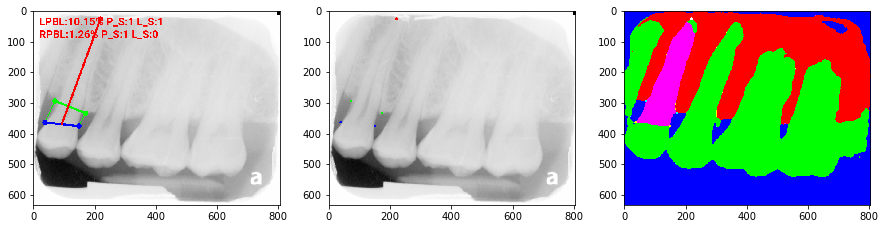

 76%|███████▌  | 362/477 [00:36<00:27,  4.20it/s]

NN_180719_084925_16F368
This case got unmatch predict and label


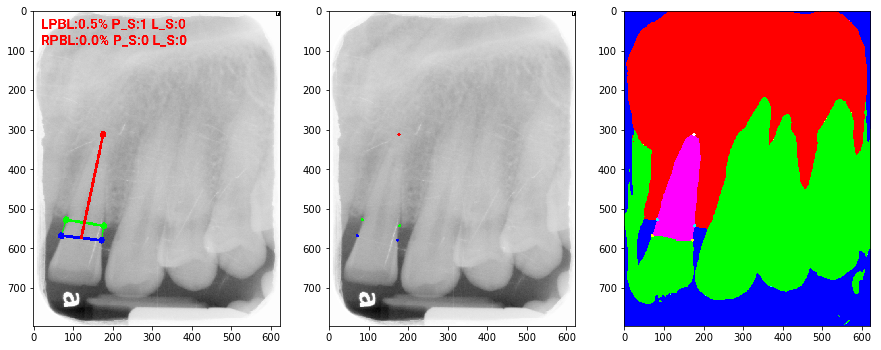

 78%|███████▊  | 373/477 [00:37<00:18,  5.54it/s]

NN_180719_084926_16F36D
This case got unmatch predict and label


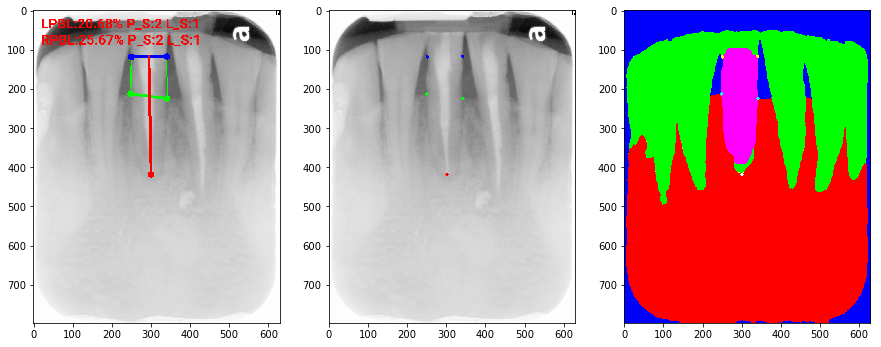

 80%|████████  | 382/477 [00:37<00:13,  7.11it/s]

NN_180719_084926_16F371
This case got unmatch predict and label


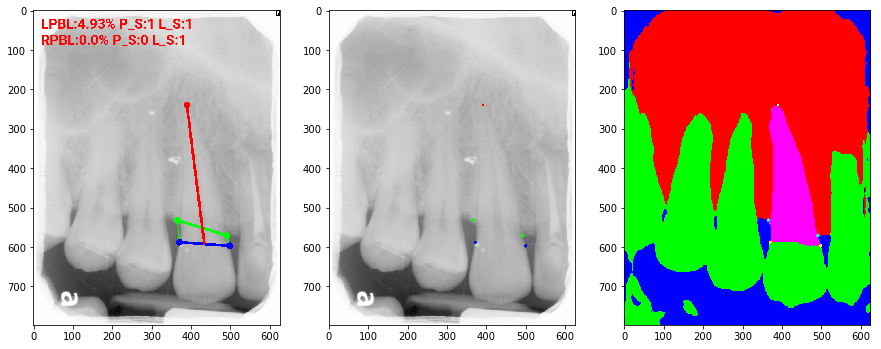

 81%|████████  | 385/477 [00:38<00:12,  7.20it/s]

NN_180719_084945_16F372
This case got unmatch predict and label


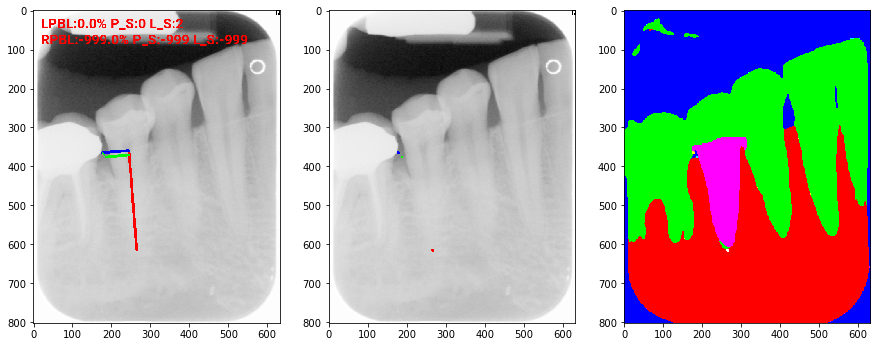

 82%|████████▏ | 390/477 [00:38<00:10,  8.19it/s]

NN_190923_111146_4B151
This case got unmatch predict and label


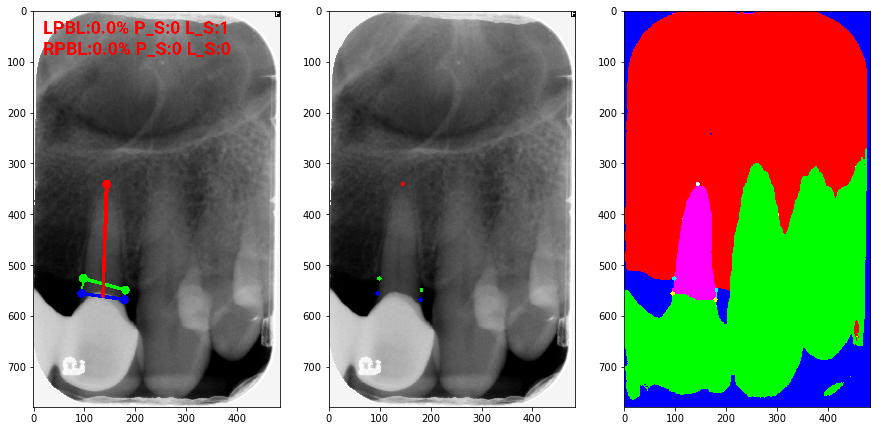

 85%|████████▌ | 407/477 [00:38<00:06, 10.82it/s]

NN_190923_111212_4B148
This case got unmatch predict and label


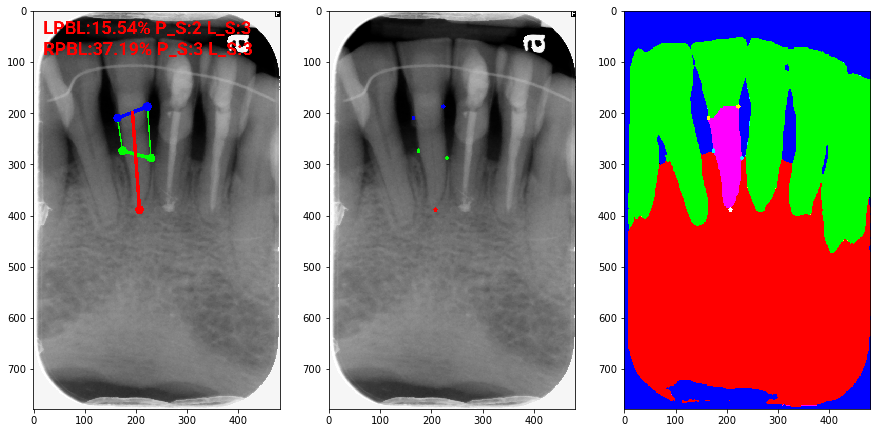

 88%|████████▊ | 418/477 [00:39<00:04, 13.23it/s]

NN_190923_111219_4B150
This case got unmatch predict and label


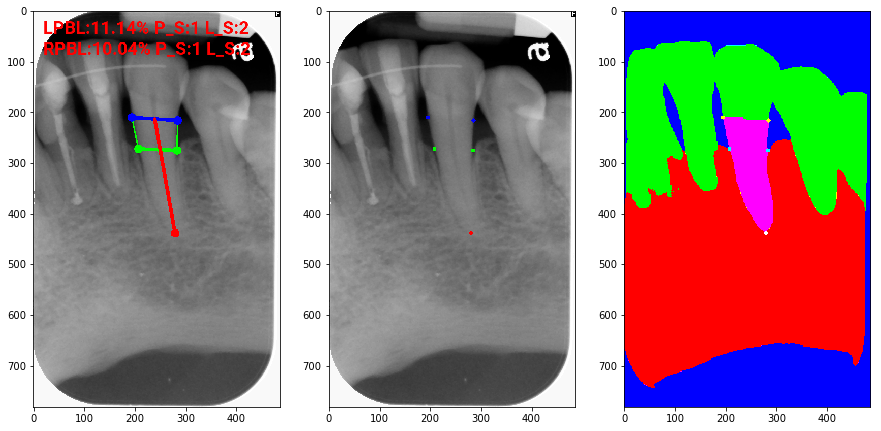

 88%|████████▊ | 421/477 [00:39<00:05,  9.86it/s]

NN_190923_111219_4B150
This case got unmatch predict and label


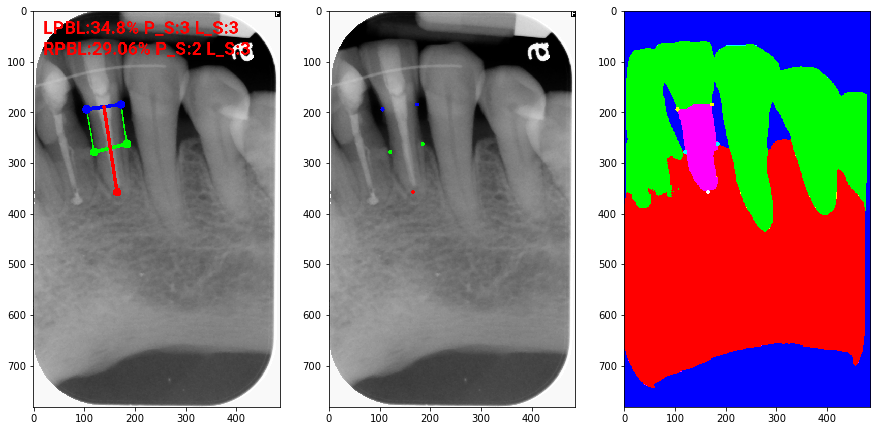

 89%|████████▉ | 424/477 [00:40<00:05,  9.04it/s]

NN_190923_113444_4B144
This case got unmatch predict and label


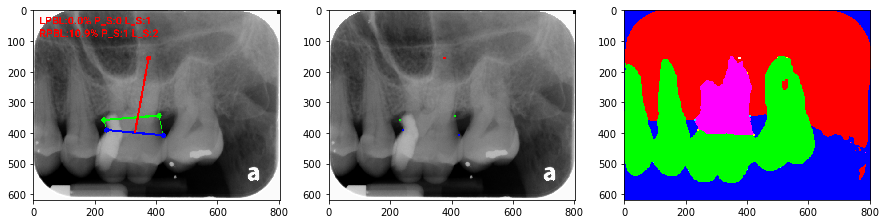

 92%|█████████▏| 438/477 [00:40<00:03, 11.65it/s]

NN_190923_113444_4B144
This case got unmatch predict and label


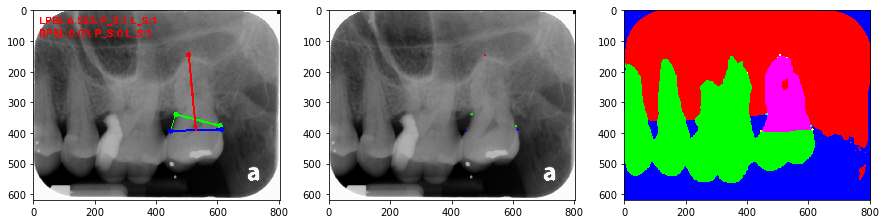

NN_190923_113444_4B144
This case got unmatch predict and label


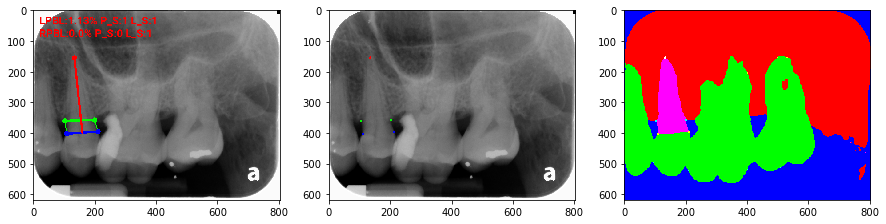

 92%|█████████▏| 441/477 [00:41<00:04,  7.21it/s]

NN__191111_145307_24202
This case got unmatch predict and label


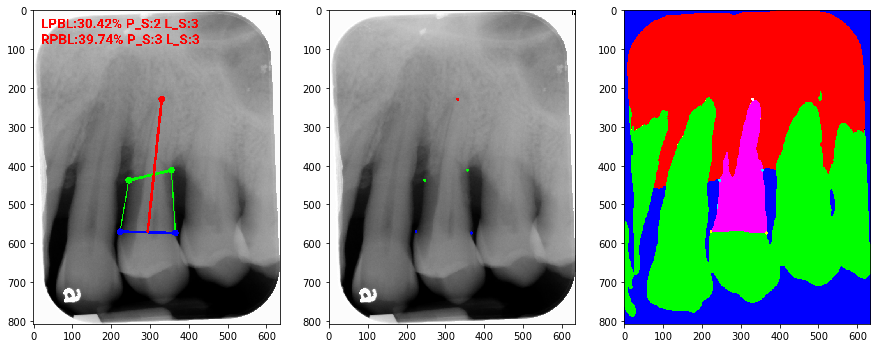

 93%|█████████▎| 443/477 [00:41<00:05,  5.85it/s]

NN__191111_145307_24202
This case got unmatch predict and label


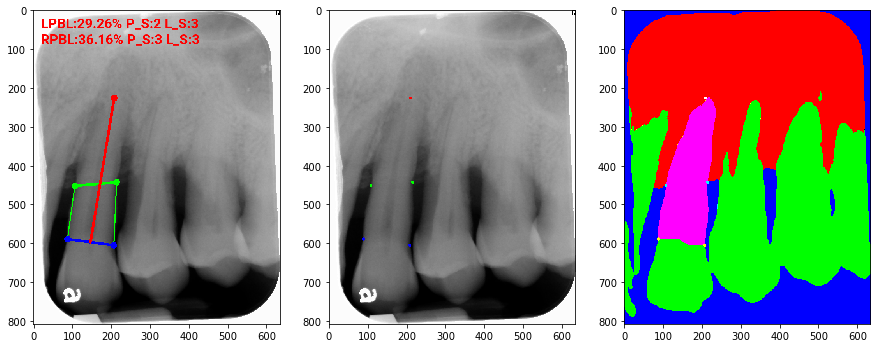

 94%|█████████▎| 446/477 [00:42<00:05,  6.06it/s]

NN__191111_145309_24203
This case got unmatch predict and label


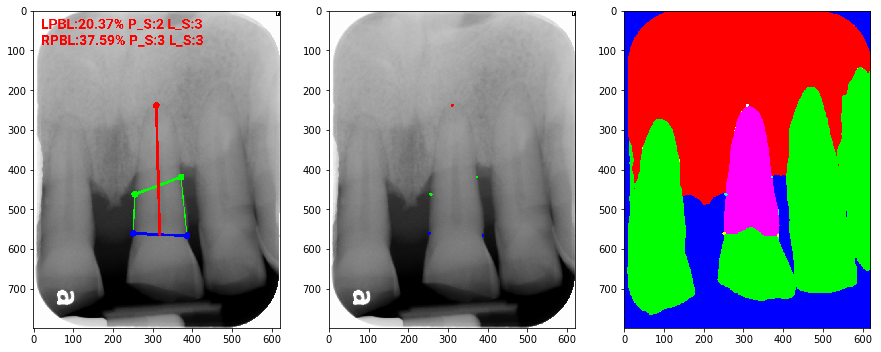

 94%|█████████▍| 448/477 [00:42<00:05,  5.65it/s]

NN__191111_145309_24204
This case got unmatch predict and label


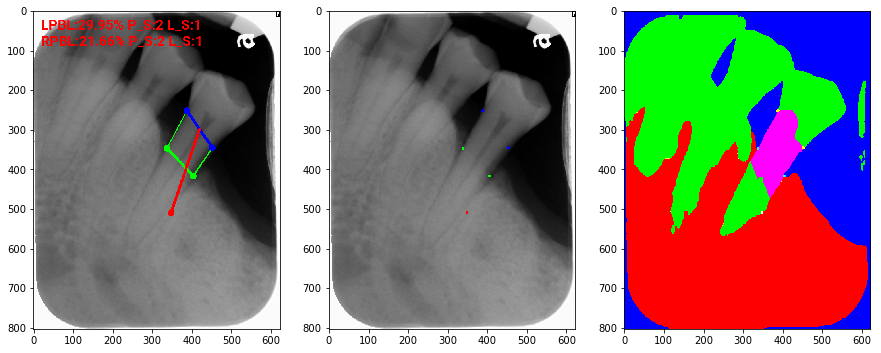

 94%|█████████▍| 450/477 [00:43<00:05,  5.12it/s]

NN__191111_145337_24208
This case got unmatch predict and label


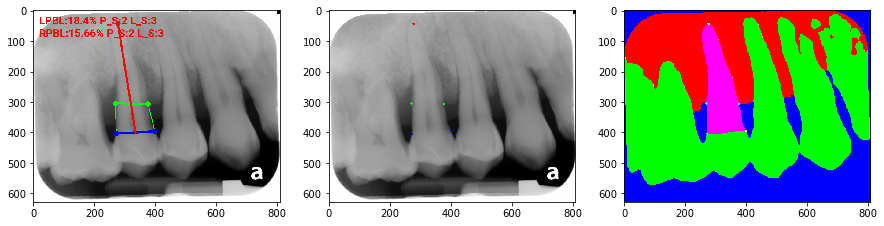

 97%|█████████▋| 461/477 [00:43<00:02,  6.79it/s]

NN__191111_145402_2420A
This case got unmatch predict and label


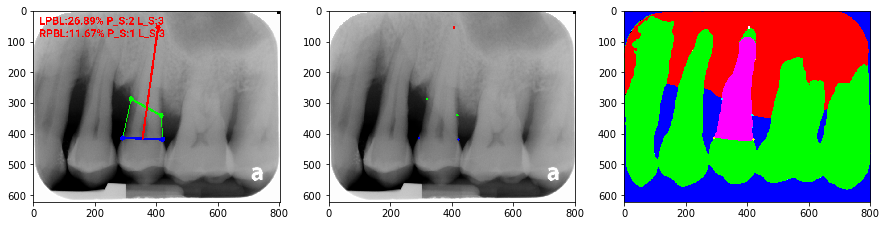

 97%|█████████▋| 464/477 [00:44<00:01,  7.08it/s]

NN__191111_145402_2420C
This case got unmatch predict and label


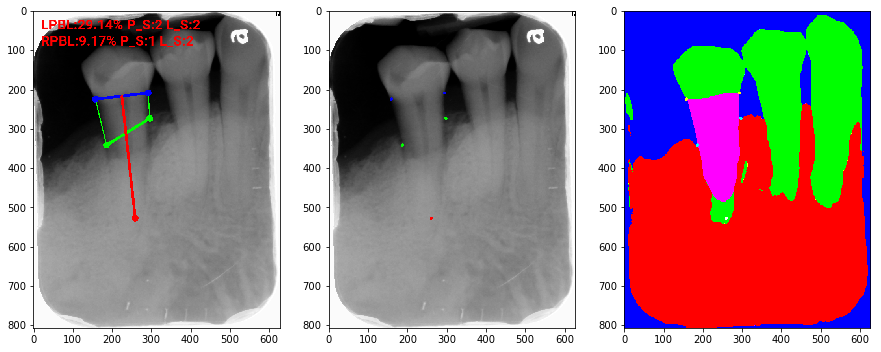

 98%|█████████▊| 468/477 [00:44<00:01,  7.35it/s]

NN__191111_145403_2420D
This case got unmatch predict and label


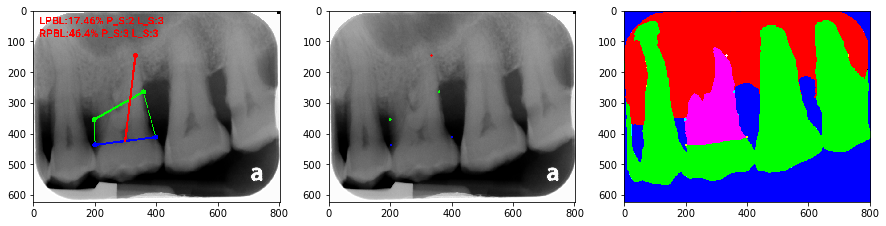

100%|██████████| 477/477 [00:44<00:00, 10.62it/s]


In [8]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_o_image'
seg_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_seg_image'
path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/*.PNG'
image_path_list = glob.glob(path)

count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    if image_name[-2:-1] == '0':
        o_image_name = image_name[:-8]
        print(o_image_name)
        print('This case got unmatch predict and label')
        o_image_path = os.path.join(o_img_folder,o_image_name)
        seg_image_path = os.path.join(seg_img_folder,o_image_name)
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_o_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_seg_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass

In [9]:
print(count)

106


  0%|          | 0/477 [00:00<?, ?it/s]

This case is human can predict but model can not.


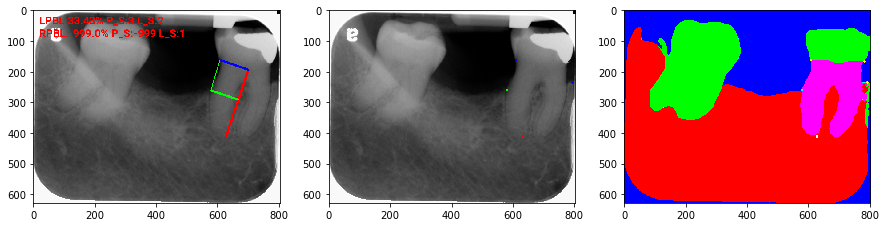

  0%|          | 2/477 [00:00<01:39,  4.79it/s]

This case is human can predict but model can not.


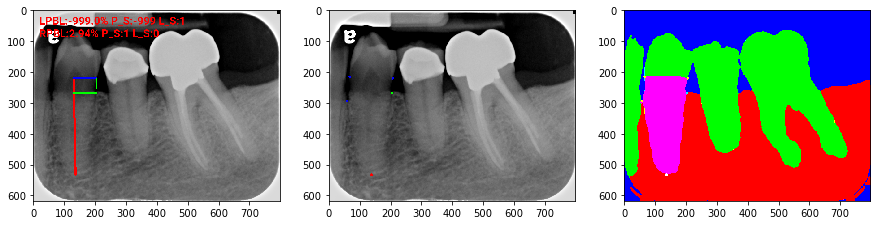

  1%|▏         | 6/477 [00:00<01:24,  5.54it/s]

This case is human can predict but model can not.


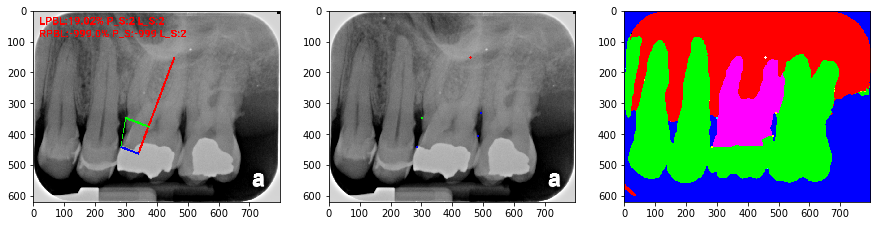

  3%|▎         | 16/477 [00:01<01:03,  7.22it/s]

This case is human can predict but model can not.


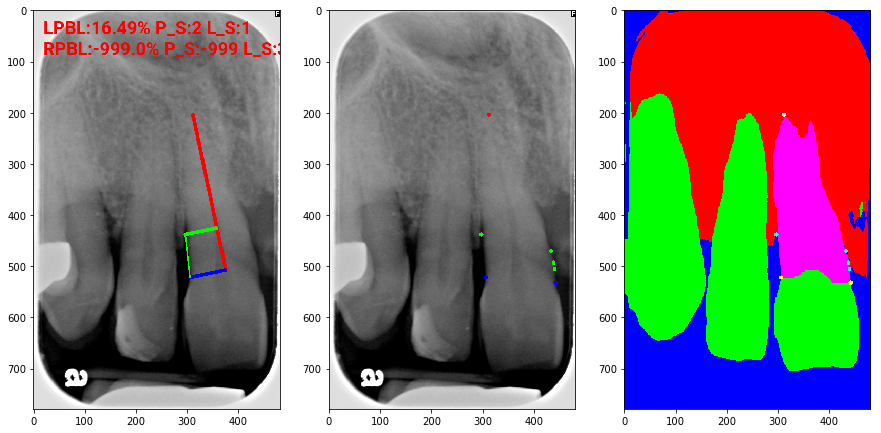

  6%|▋         | 31/477 [00:01<00:47,  9.43it/s]

This case is human can predict but model can not.


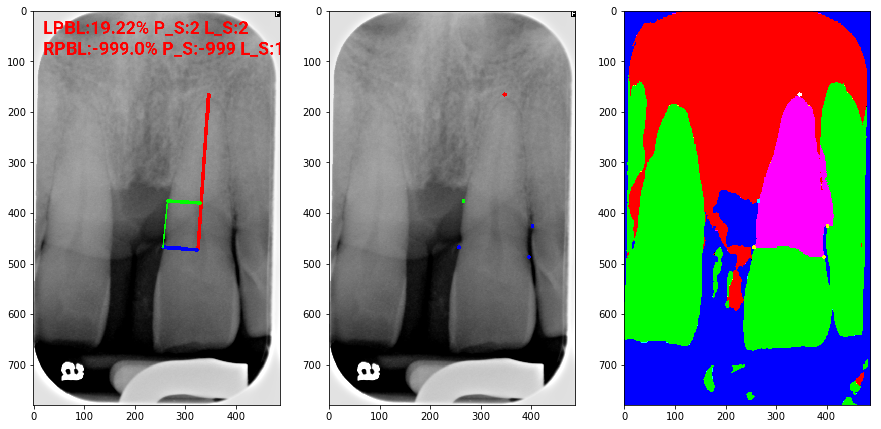

  7%|▋         | 34/477 [00:02<00:52,  8.45it/s]

This case is human can predict but model can not.


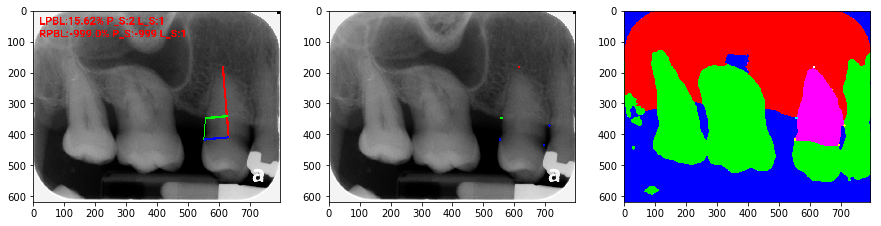

 12%|█▏        | 56/477 [00:02<00:37, 11.28it/s]

This case is human can predict but model can not.


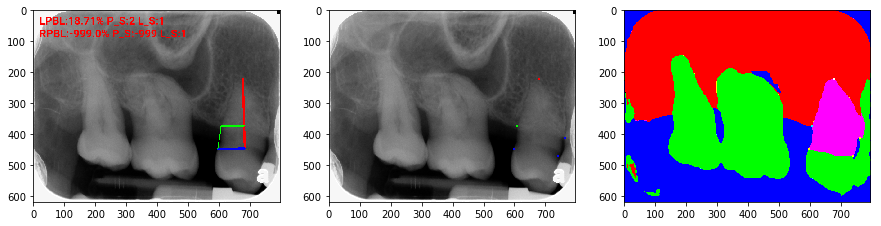

 17%|█▋        | 79/477 [00:02<00:26, 14.90it/s]

This case is human can predict but model can not.


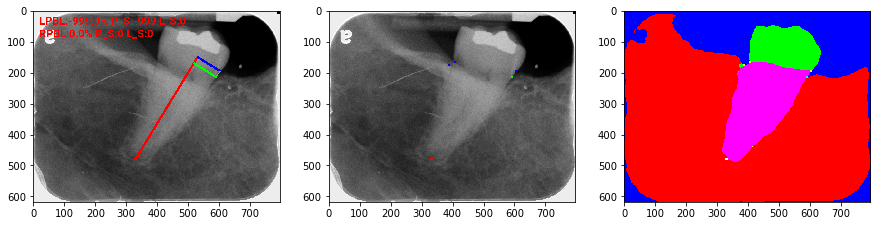

 23%|██▎       | 110/477 [00:03<00:18, 19.71it/s]

This case is human can predict but model can not.


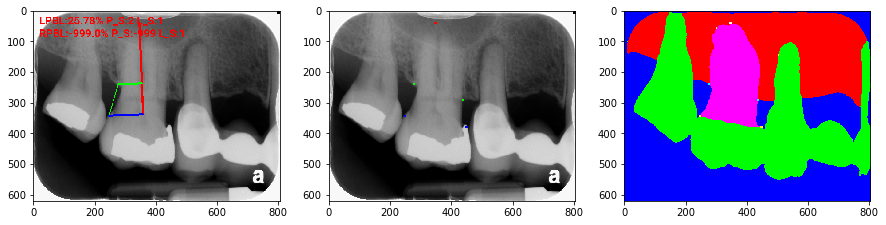

 26%|██▌       | 124/477 [00:03<00:15, 23.06it/s]

This case is human can predict but model can not.


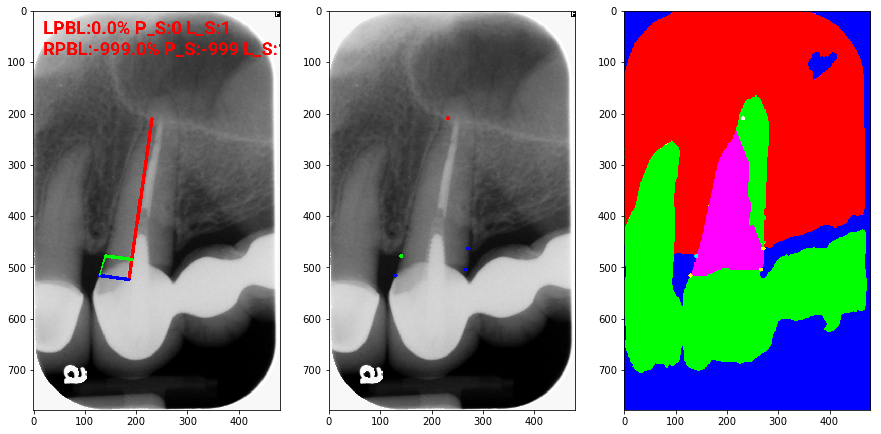

 30%|██▉       | 143/477 [00:04<00:13, 25.15it/s]

This case is human can predict but model can not.


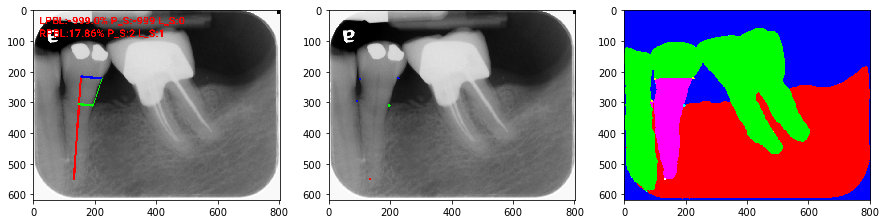

 31%|███       | 148/477 [00:04<00:17, 18.76it/s]

This case is human can predict but model can not.


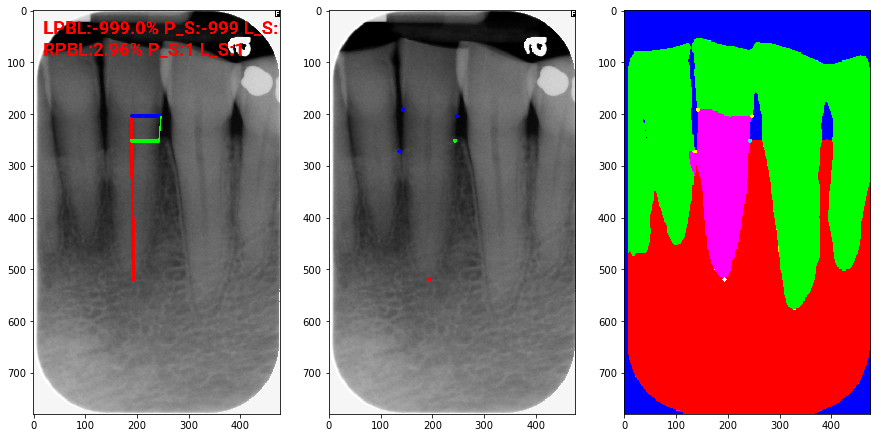

This case is human can predict but model can not.


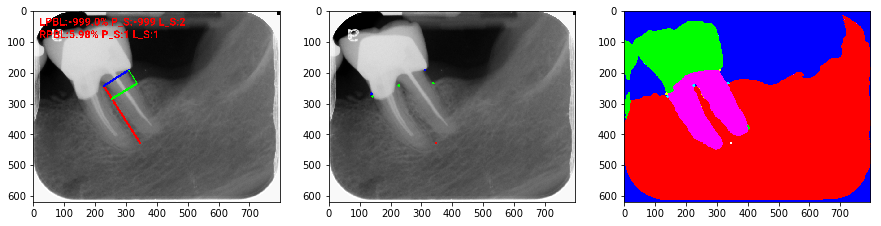

 32%|███▏      | 152/477 [00:05<00:32, 10.08it/s]

This case is human can predict but model can not.


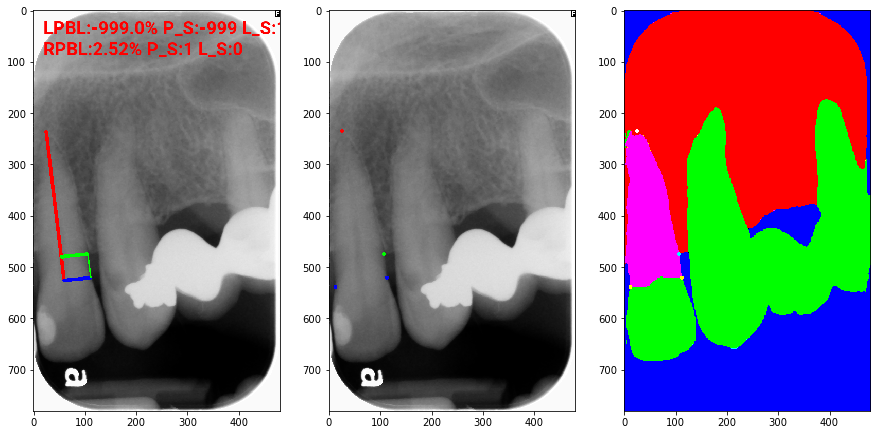

 43%|████▎     | 203/477 [00:05<00:19, 13.93it/s]

This case is human can predict but model can not.


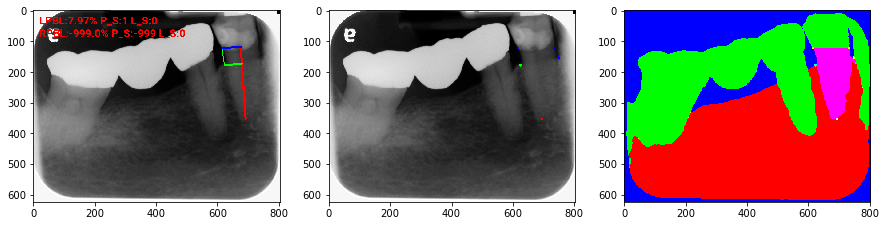

 44%|████▍     | 211/477 [00:06<00:18, 14.74it/s]

This case is human can predict but model can not.


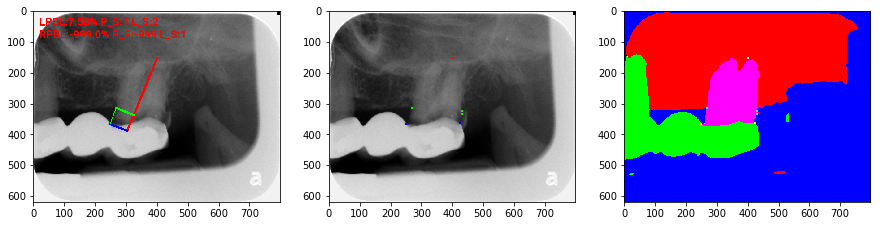

 45%|████▌     | 216/477 [00:06<00:18, 14.06it/s]

This case is human can predict but model can not.


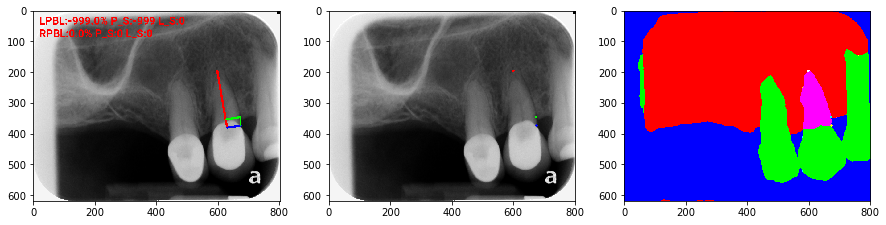

 46%|████▌     | 220/477 [00:07<00:20, 12.80it/s]

This case is human can predict but model can not.


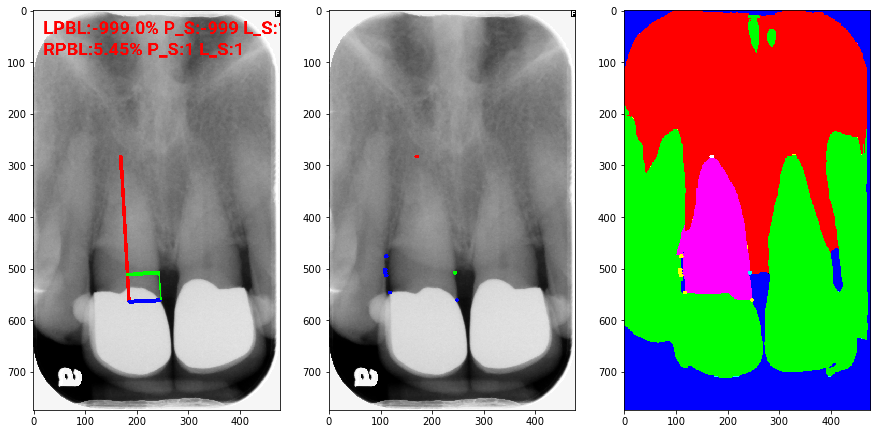

 47%|████▋     | 223/477 [00:07<00:25,  9.85it/s]

This case is human can predict but model can not.


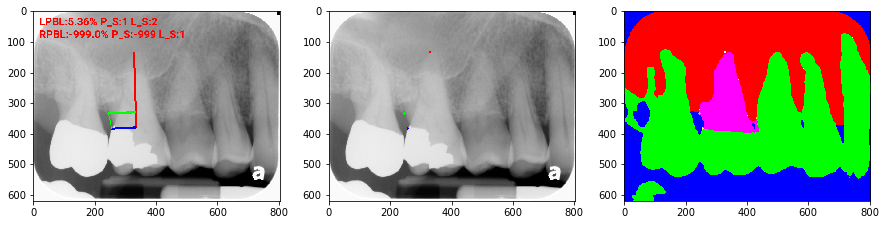

 48%|████▊     | 231/477 [00:08<00:20, 11.82it/s]

This case is human can predict but model can not.


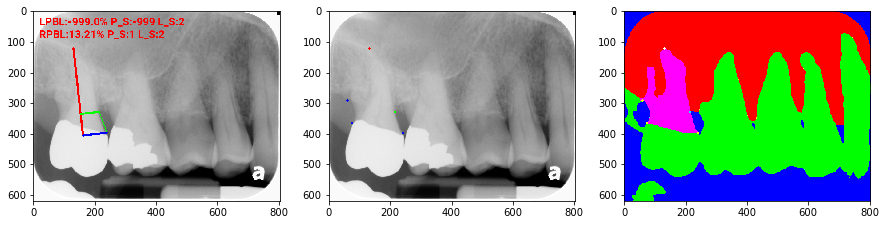

This case is human can predict but model can not.


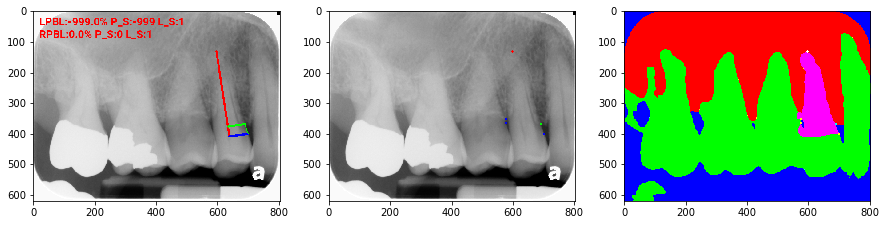

 49%|████▉     | 234/477 [00:08<00:34,  7.07it/s]

This case is human can predict but model can not.


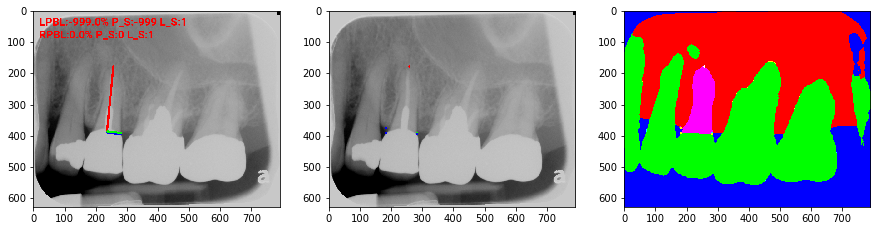

 59%|█████▊    | 280/477 [00:09<00:19,  9.86it/s]

This case is human can predict but model can not.


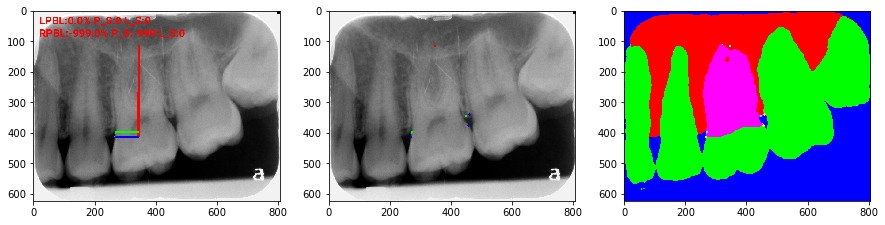

 62%|██████▏   | 298/477 [00:09<00:13, 12.96it/s]

This case is human can predict but model can not.


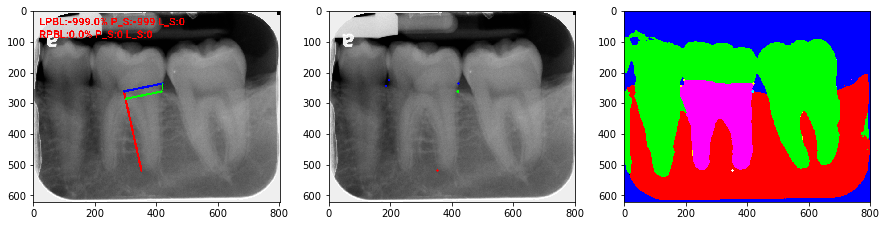

 65%|██████▍   | 308/477 [00:10<00:11, 15.08it/s]

This case is human can predict but model can not.


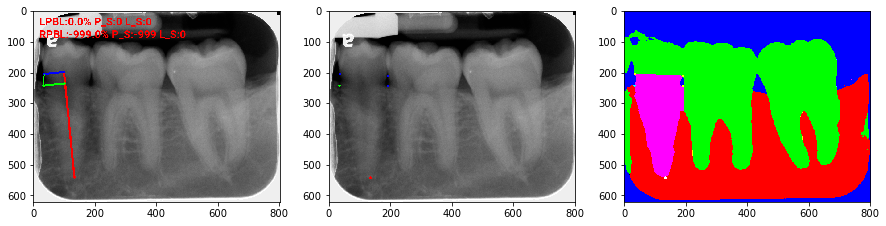

 66%|██████▌   | 313/477 [00:10<00:11, 14.14it/s]

This case is human can predict but model can not.


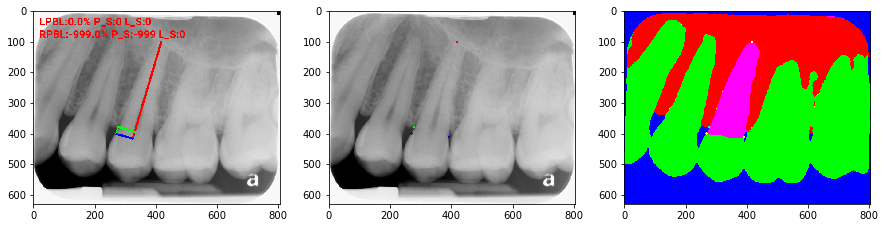

 70%|███████   | 336/477 [00:10<00:07, 17.92it/s]

This case is human can predict but model can not.


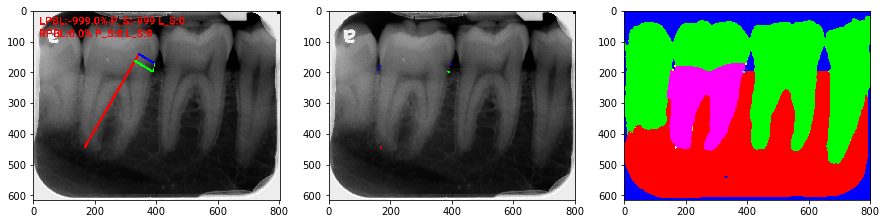

 72%|███████▏  | 342/477 [00:11<00:07, 16.90it/s]

This case is human can predict but model can not.


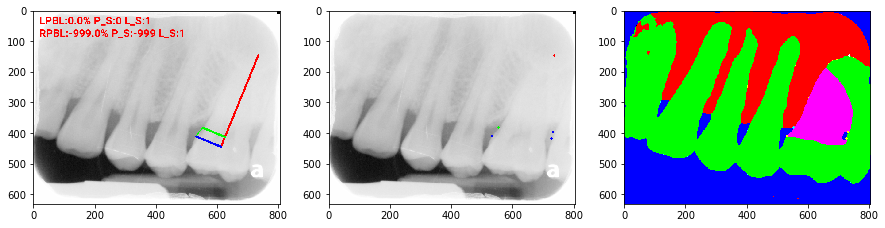

 73%|███████▎  | 346/477 [00:11<00:09, 13.95it/s]

This case is human can predict but model can not.


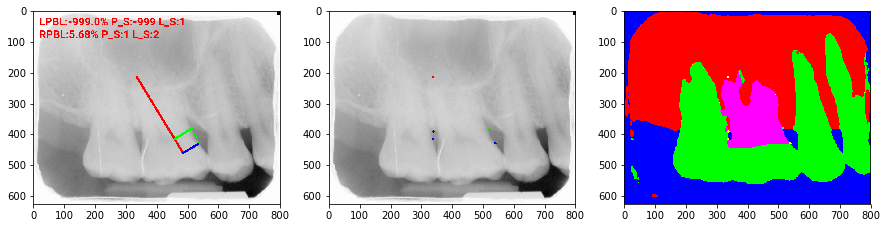

 74%|███████▎  | 351/477 [00:12<00:09, 13.37it/s]

This case is human can predict but model can not.


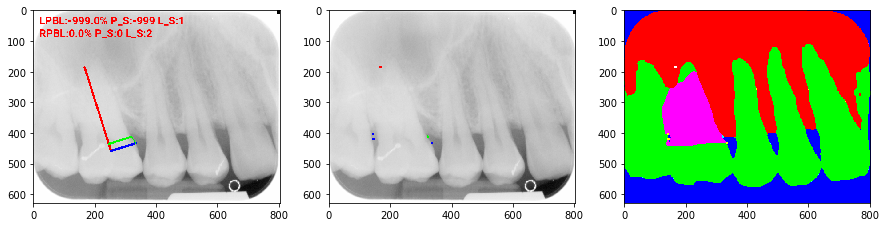

 75%|███████▍  | 357/477 [00:12<00:08, 13.77it/s]

This case is human can predict but model can not.


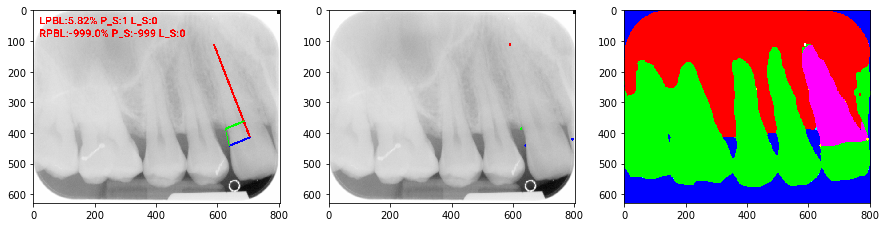

 75%|███████▌  | 359/477 [00:12<00:13,  9.05it/s]

This case is human can predict but model can not.


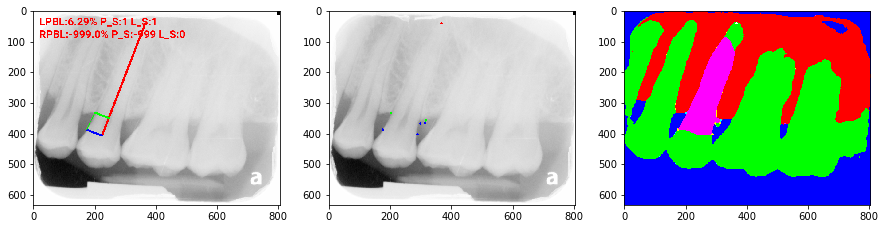

 76%|███████▌  | 361/477 [00:13<00:16,  6.95it/s]

This case is human can predict but model can not.


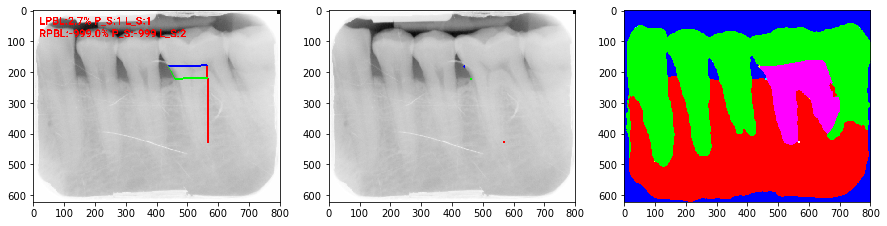

 77%|███████▋  | 368/477 [00:13<00:12,  8.48it/s]

This case is human can predict but model can not.


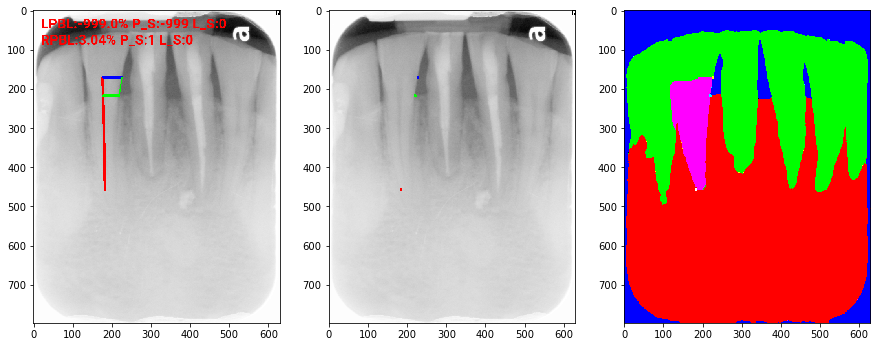

 80%|███████▉  | 380/477 [00:14<00:09, 10.70it/s]

This case is human can predict but model can not.


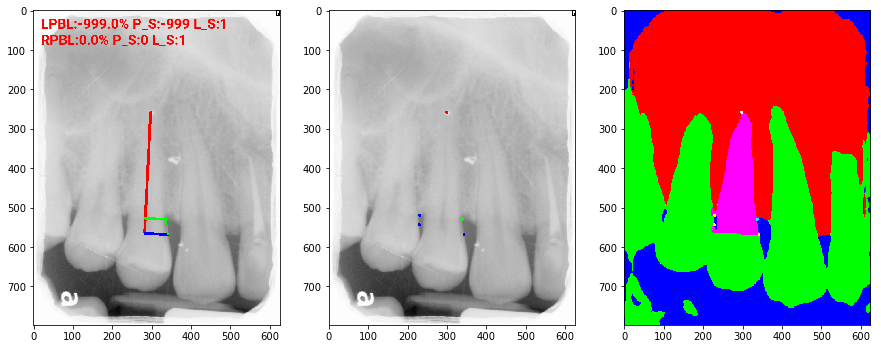

 80%|████████  | 383/477 [00:14<00:10,  9.02it/s]

This case is human can predict but model can not.


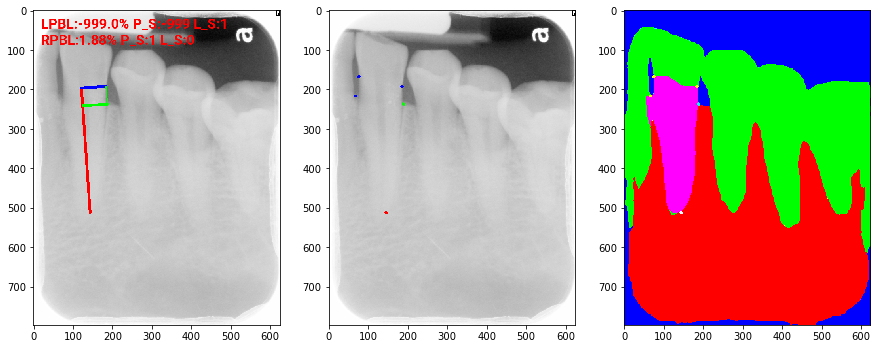

 81%|████████▏ | 388/477 [00:15<00:09,  9.42it/s]

This case is human can predict but model can not.


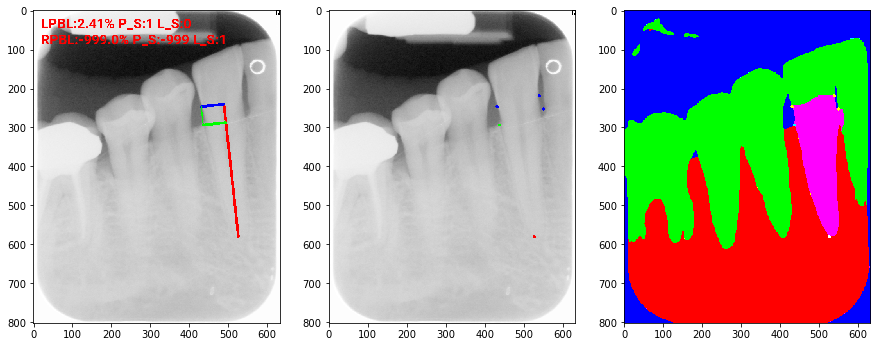

 82%|████████▏ | 392/477 [00:15<00:10,  8.39it/s]

This case is human can predict but model can not.


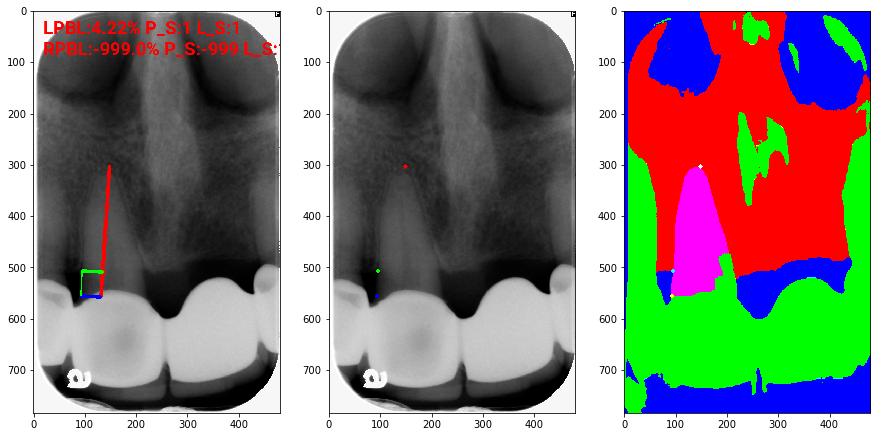

 85%|████████▍ | 405/477 [00:16<00:06, 10.67it/s]

This case is human can predict but model can not.


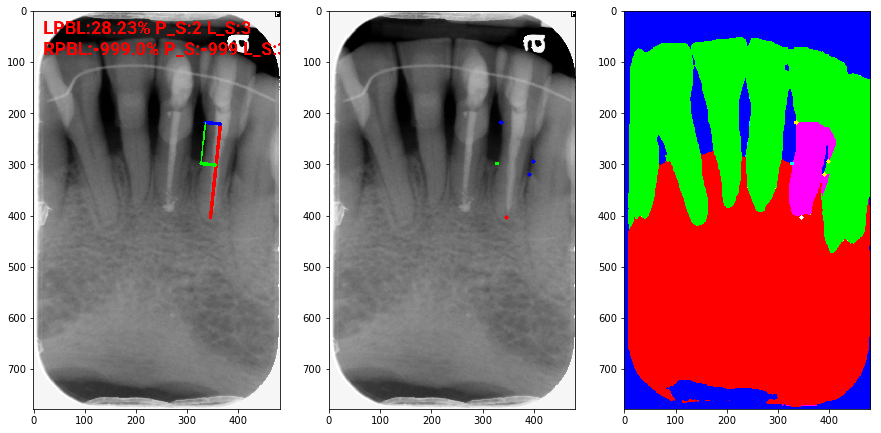

 87%|████████▋ | 417/477 [00:16<00:04, 13.25it/s]

This case is human can predict but model can not.


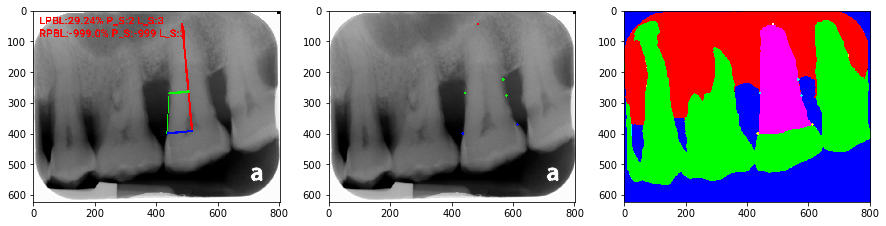

100%|██████████| 477/477 [00:16<00:00, 28.11it/s]


In [10]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_o_image'
seg_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_seg_image'
path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/*.PNG'
image_path_list = glob.glob(path)

count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    if image_name[-2:-1] == '1':
        o_image_name = image_name[:-8]
        print('This case is human can predict but model can not.')
        o_image_path = os.path.join(o_img_folder,o_image_name)
        seg_image_path = os.path.join(seg_img_folder,o_image_name)
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_o_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_seg_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass

In [11]:
print(count)

40


In [12]:
# img = cv2.imread('/root/notebooks/tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/NN_130821_101512_C057C4_1_err12.PNG')
# img.shape
# plt.imshow(img)

  0%|          | 0/477 [00:00<?, ?it/s]

NN__191111_145337_24208
This case is model can predict but human can not.


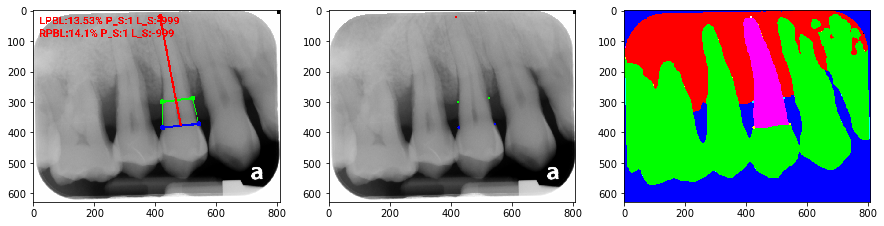

  1%|          | 4/477 [00:00<00:45, 10.43it/s]

NN_130821_101247_C057C1
This case is model can predict but human can not.


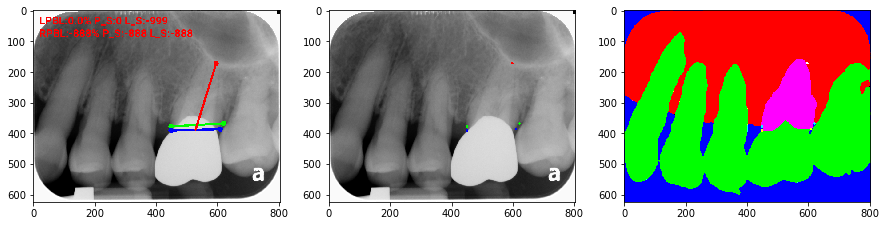

 11%|█▏        | 54/477 [00:00<00:29, 14.43it/s]

NN_151111_112208_C0ADD1
This case is model can predict but human can not.


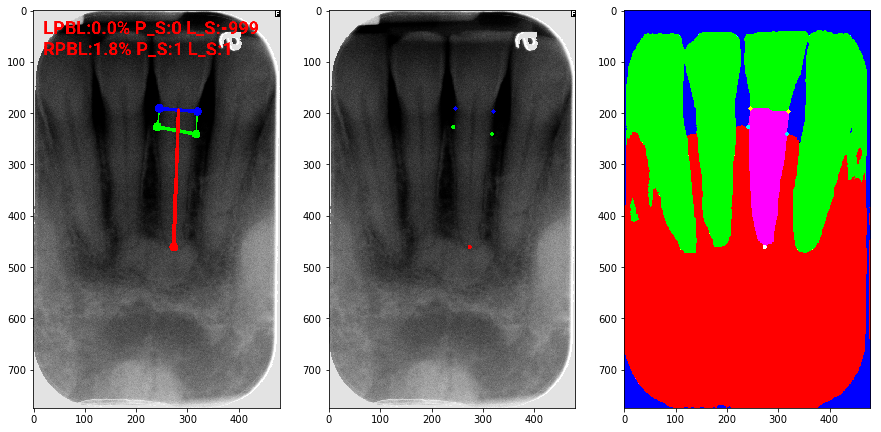

 22%|██▏       | 105/477 [00:01<00:19, 19.54it/s]

NN_160212_152909_9C3C72
This case is model can predict but human can not.


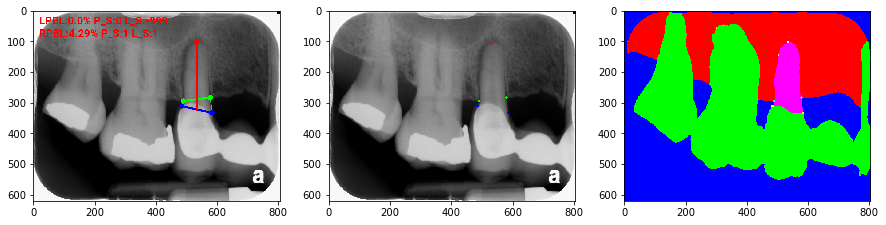

 26%|██▌       | 125/477 [00:01<00:14, 23.66it/s]

NN_160217_094559_16D992
This case is model can predict but human can not.


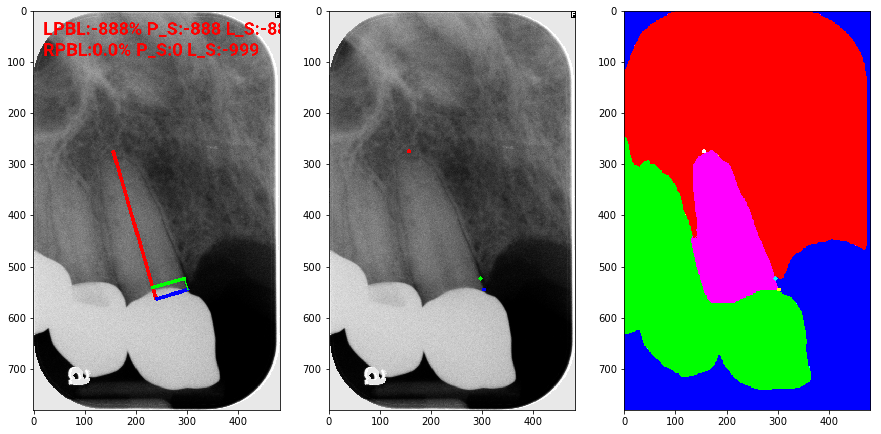

 36%|███▌      | 172/477 [00:02<00:09, 30.68it/s]

NN_160217_094620_16D993
This case is model can predict but human can not.


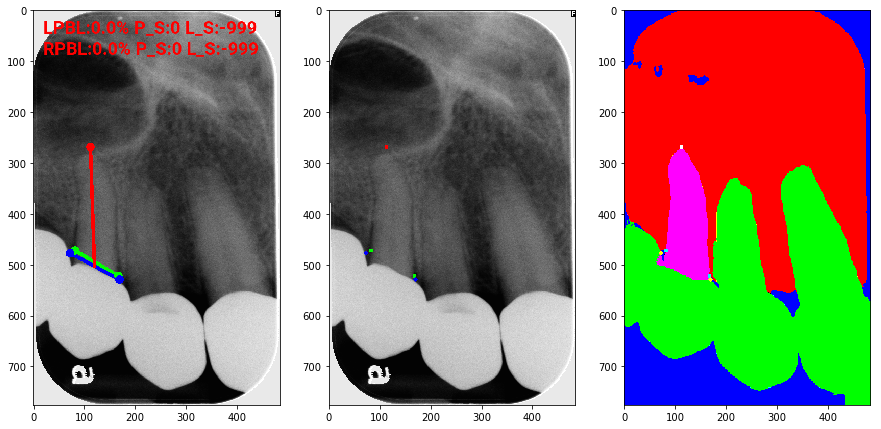

 38%|███▊      | 182/477 [00:02<00:10, 28.18it/s]

NN_160217_094634_16D99A
This case is model can predict but human can not.


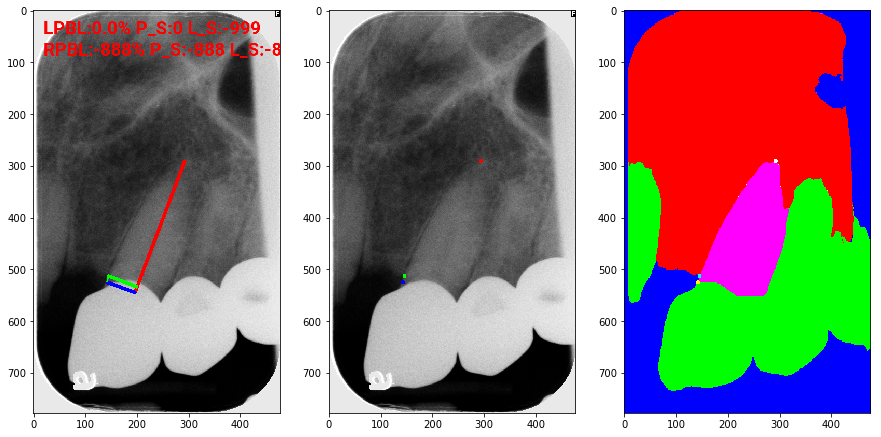

 39%|███▉      | 188/477 [00:03<00:14, 20.30it/s]

NN_161012_105927_C03832
This case is model can predict but human can not.


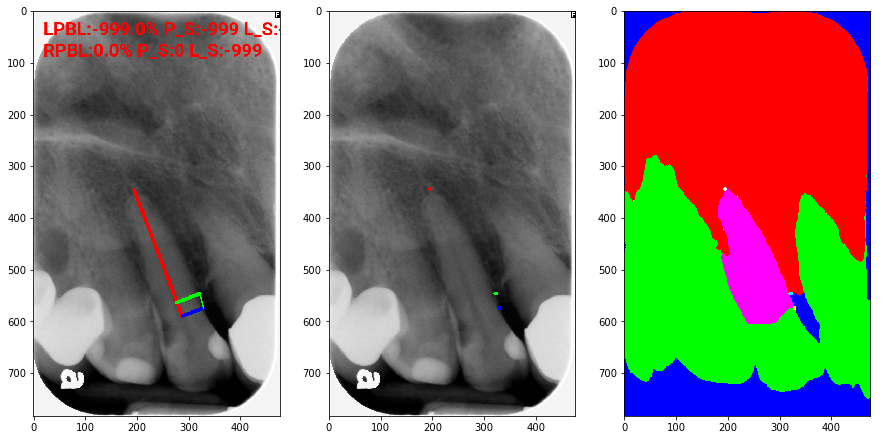

 41%|████▏     | 197/477 [00:03<00:13, 20.22it/s]

NN_161012_105956_C0382E
This case is model can predict but human can not.


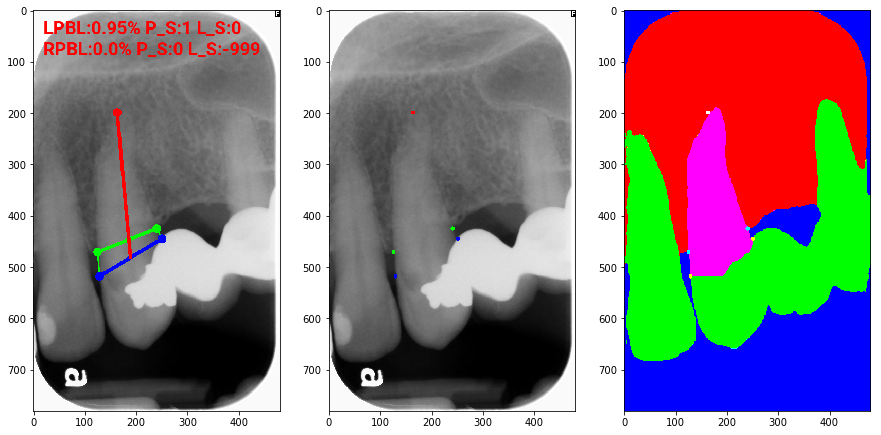

 42%|████▏     | 202/477 [00:03<00:16, 16.48it/s]

NN_161012_105956_C0382E
This case is model can predict but human can not.


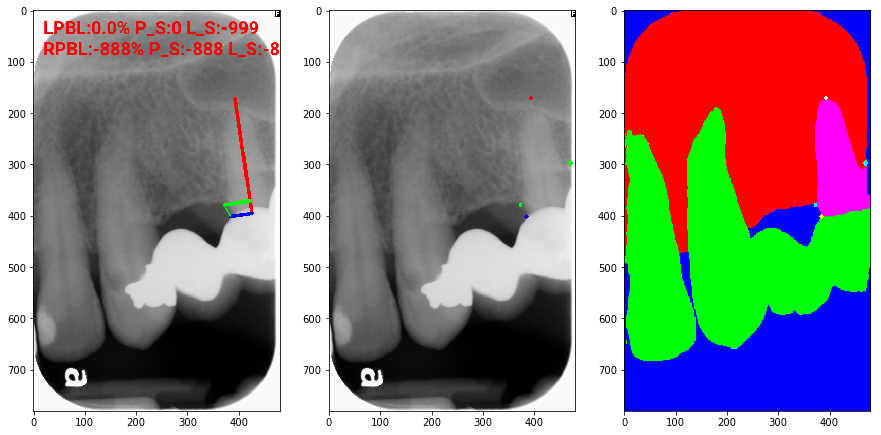

 43%|████▎     | 205/477 [00:04<00:22, 12.08it/s]

NN_161012_110008_C0382F
This case is model can predict but human can not.


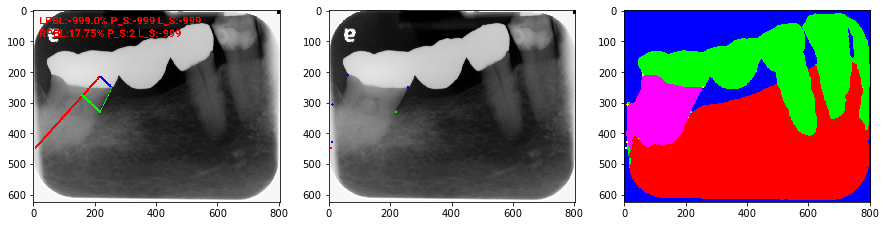

 44%|████▍     | 210/477 [00:04<00:21, 12.52it/s]

NN_161012_110107_C03839
This case is model can predict but human can not.


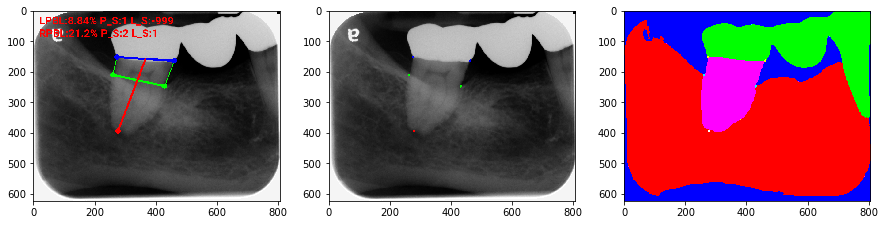

 47%|████▋     | 225/477 [00:05<00:15, 15.77it/s]

NN_161012_110111_C03830
This case is model can predict but human can not.


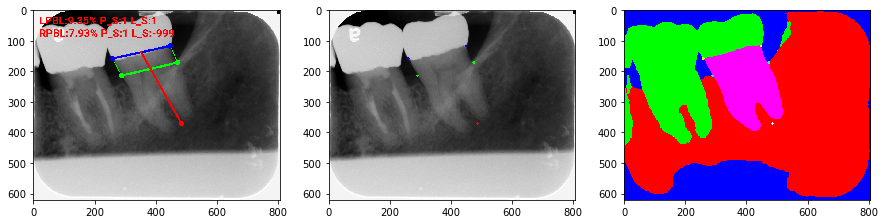

 48%|████▊     | 228/477 [00:05<00:21, 11.64it/s]

NN_180620_110656_16FA14
This case is model can predict but human can not.


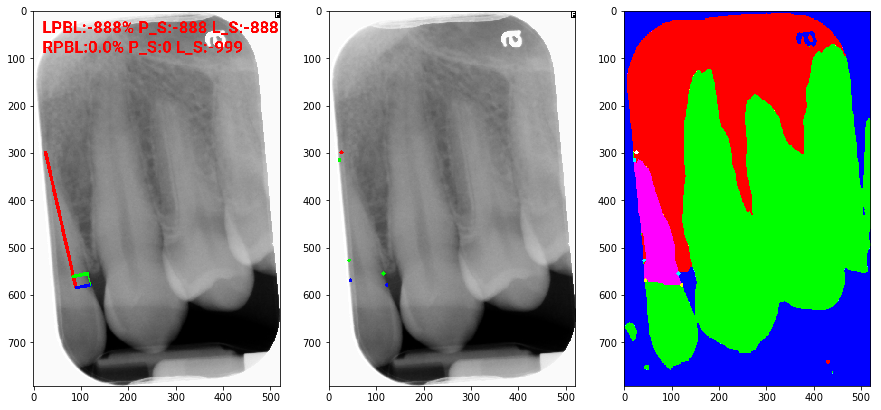

 65%|██████▌   | 312/477 [00:05<00:10, 16.20it/s]

NN_180620_110702_16FA12
This case is model can predict but human can not.


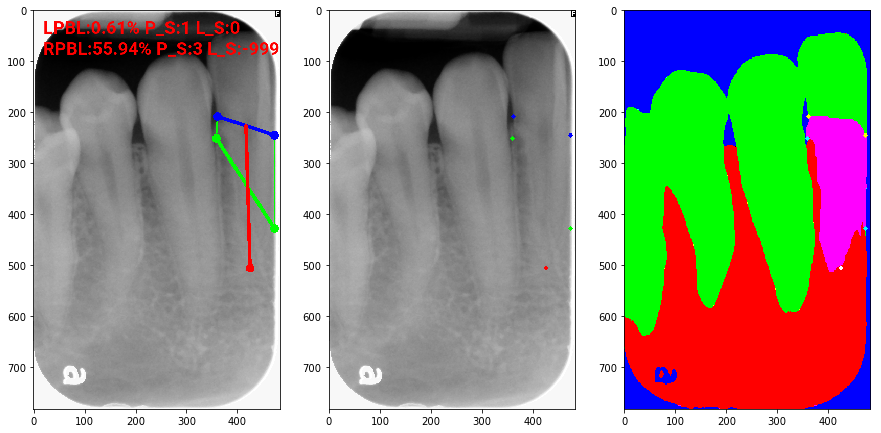

 67%|██████▋   | 320/477 [00:06<00:09, 16.85it/s]

NN_180620_113042_16FA09
This case is model can predict but human can not.


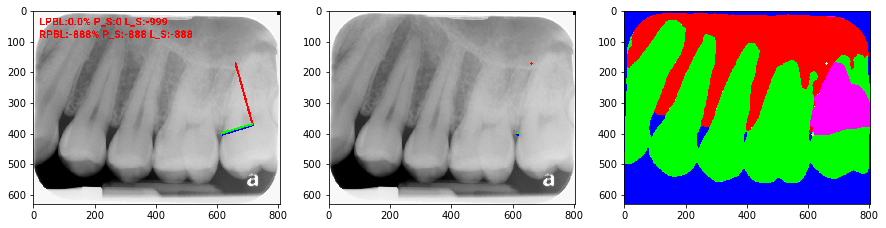

 70%|███████   | 334/477 [00:06<00:07, 19.75it/s]

NN_180620_113042_16FA09
This case is model can predict but human can not.


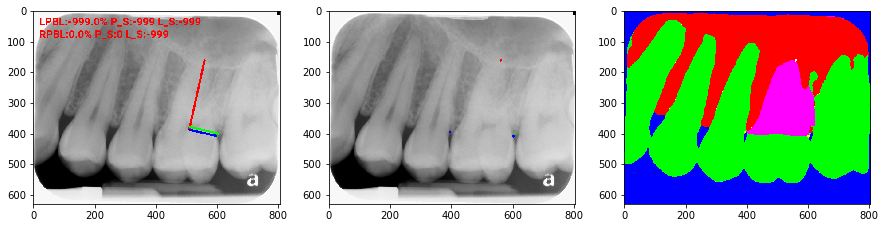

NN_180620_113130_16FA05
This case is model can predict but human can not.


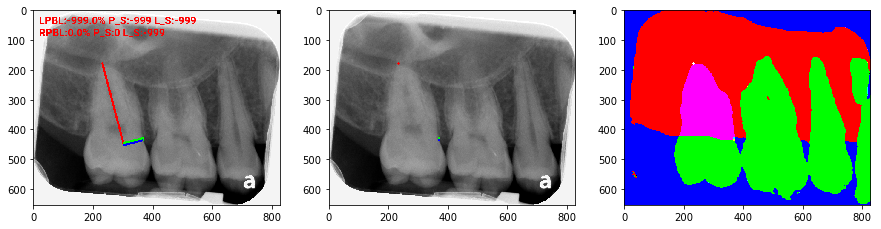

 71%|███████   | 339/477 [00:07<00:11, 11.88it/s]

NN_180620_113130_16FA05
This case is model can predict but human can not.


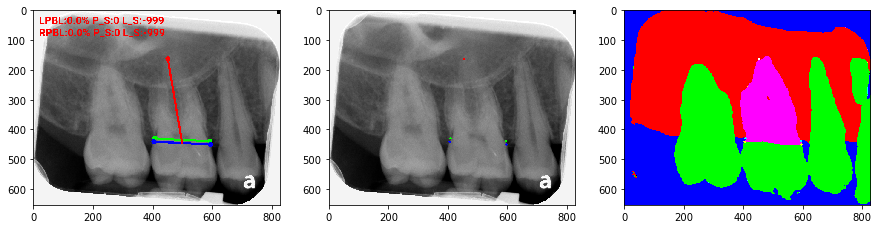

 72%|███████▏  | 343/477 [00:08<00:12, 10.56it/s]

NN_180719_084925_16F368
This case is model can predict but human can not.


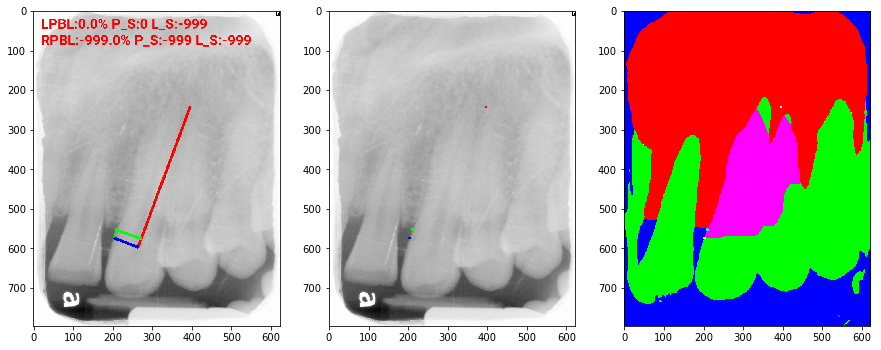

 78%|███████▊  | 374/477 [00:08<00:07, 14.16it/s]

NN_180719_084925_16F36C
This case is model can predict but human can not.


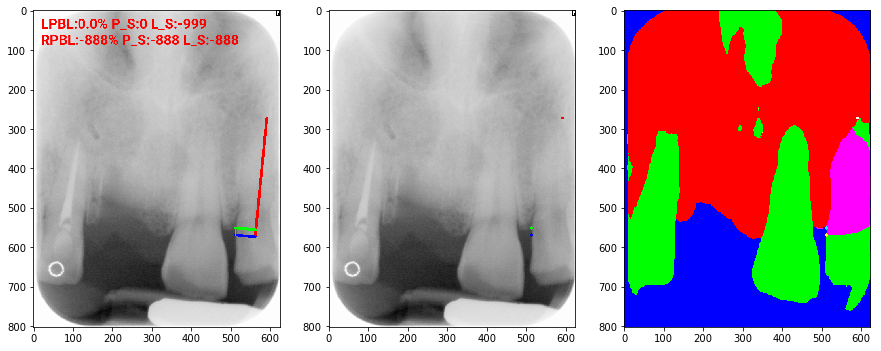

NN_180719_084925_16F36C
This case is model can predict but human can not.


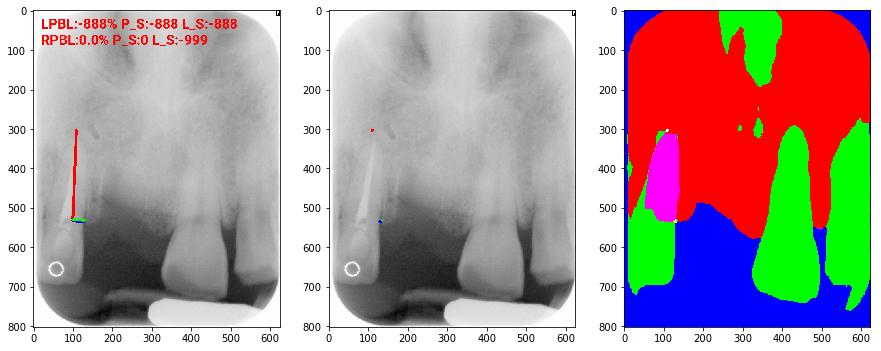

NN_180719_084925_16F36C
This case is model can predict but human can not.


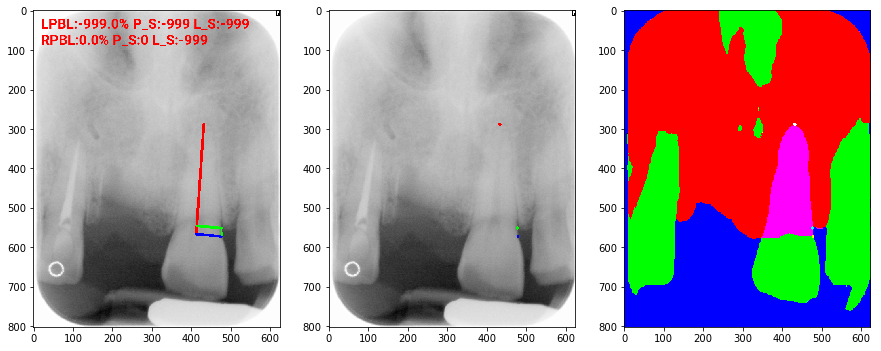

NN_180719_084926_16F36D
This case is model can predict but human can not.


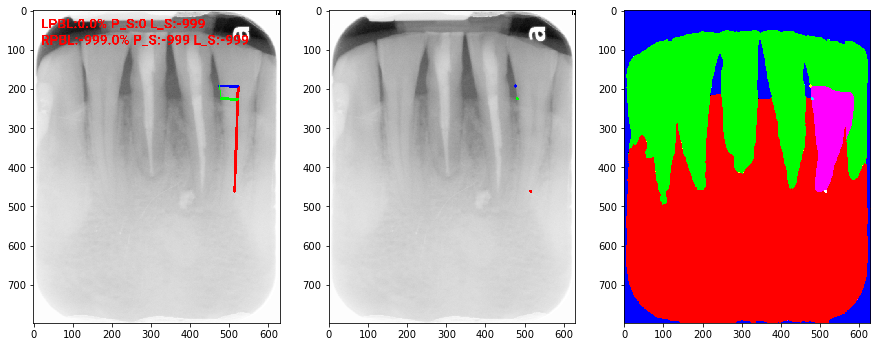

 79%|███████▉  | 379/477 [00:10<00:14,  6.58it/s]

NN_190923_111047_4B14D
This case is model can predict but human can not.


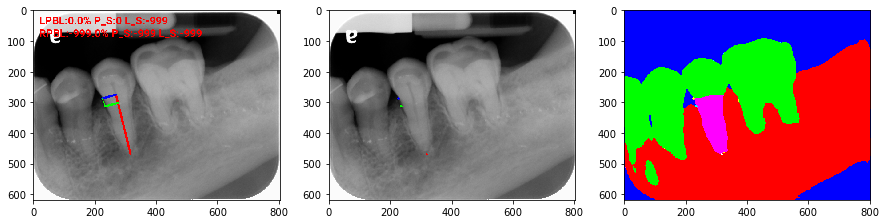

 82%|████████▏ | 393/477 [00:10<00:09,  8.59it/s]

NN_190923_111047_4B14D
This case is model can predict but human can not.


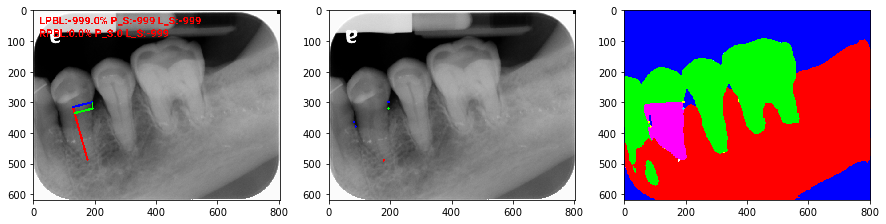

NN_190923_111056_4B146
This case is model can predict but human can not.


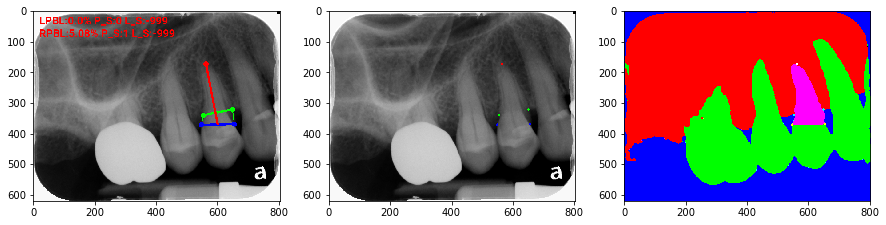

NN_190923_111056_4B146
This case is model can predict but human can not.


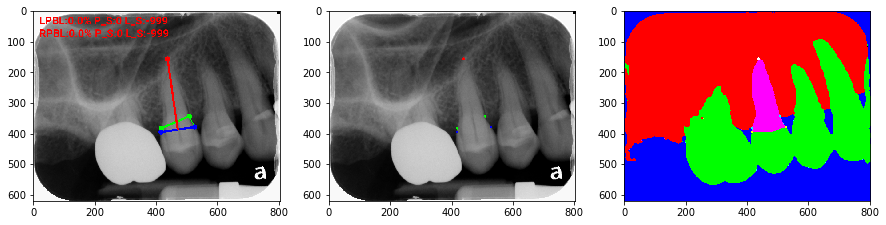

 83%|████████▎ | 396/477 [00:11<00:16,  4.95it/s]

NN_190923_111102_4B147
This case is model can predict but human can not.


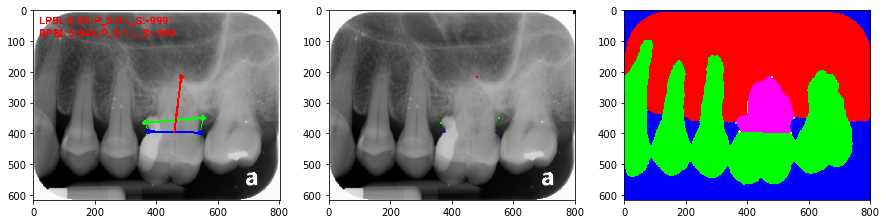

NN_190923_111102_4B147
This case is model can predict but human can not.


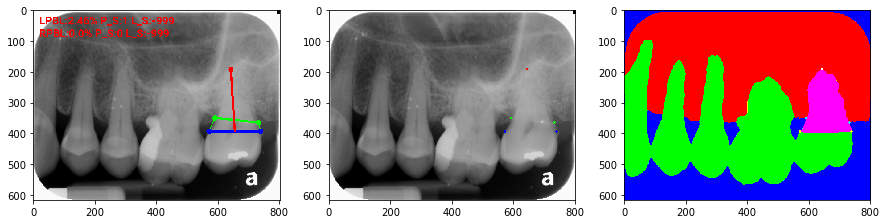

 84%|████████▎ | 399/477 [00:12<00:17,  4.41it/s]

NN_190923_111114_4B14B
This case is model can predict but human can not.


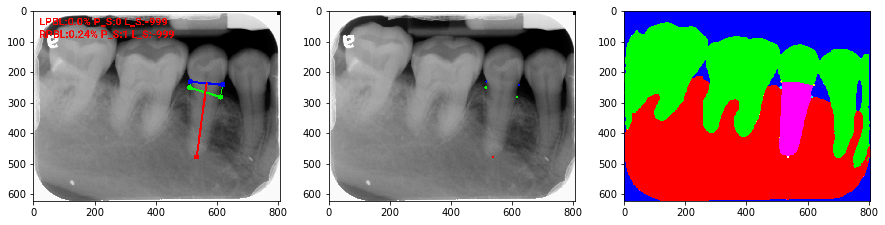

 84%|████████▍ | 403/477 [00:13<00:14,  5.28it/s]

NN_190923_111114_4B14B
This case is model can predict but human can not.


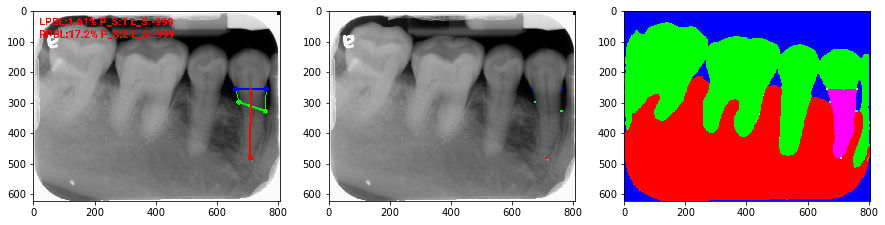

 85%|████████▍ | 405/477 [00:13<00:14,  5.10it/s]

NN_190923_111158_4B142
This case is model can predict but human can not.


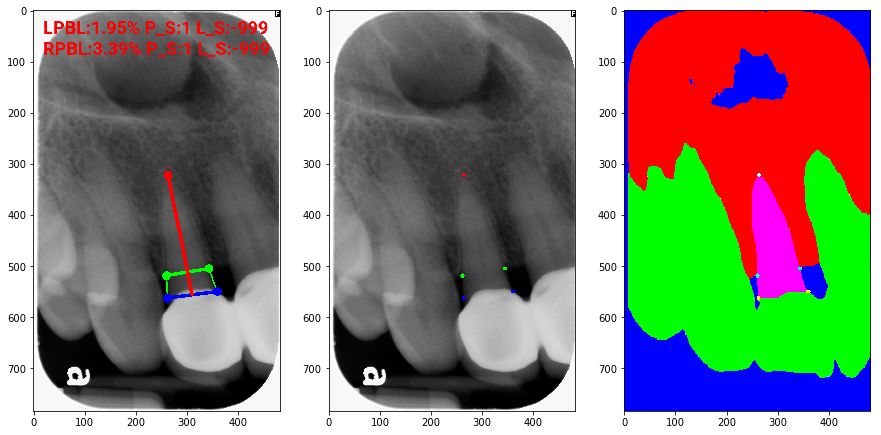

 86%|████████▌ | 409/477 [00:13<00:11,  5.91it/s]

NN_190923_111212_4B148
This case is model can predict but human can not.


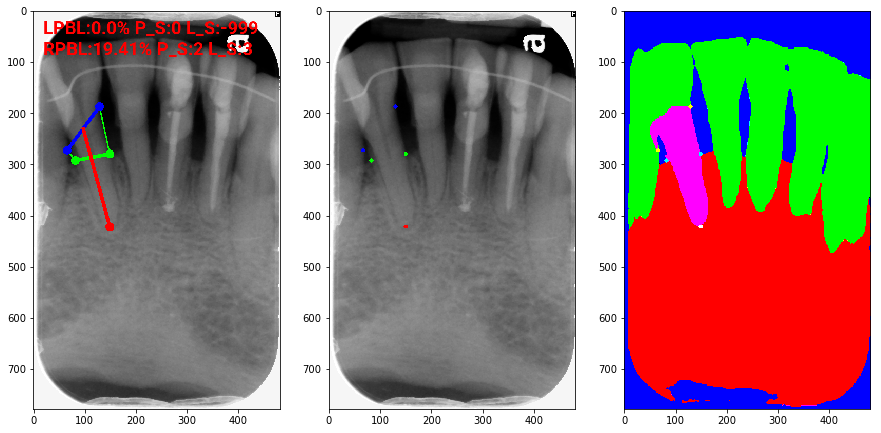

 88%|████████▊ | 419/477 [00:14<00:07,  7.58it/s]

NN_190923_111219_4B150
This case is model can predict but human can not.


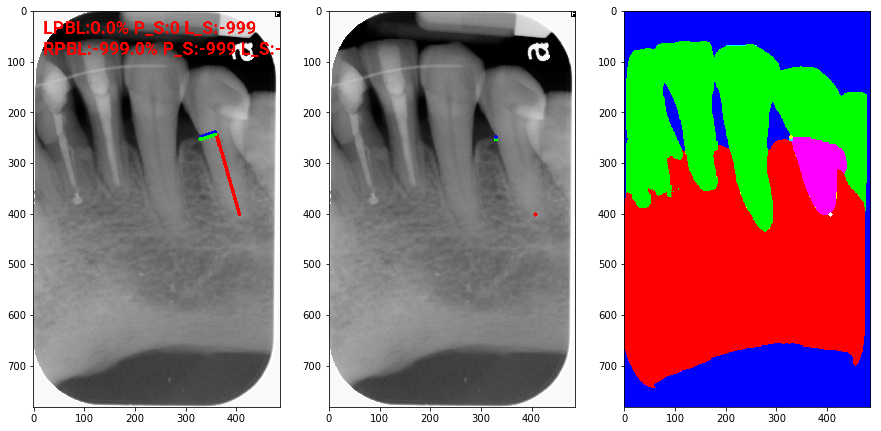

 88%|████████▊ | 422/477 [00:14<00:07,  7.13it/s]

NN_190923_112404_4B14F
This case is model can predict but human can not.


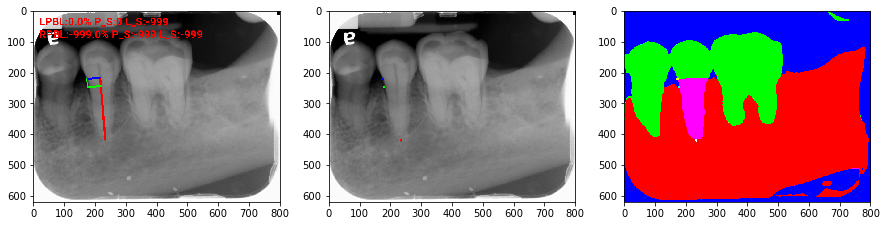

 89%|████████▉ | 425/477 [00:15<00:07,  6.82it/s]

NN_190923_112404_4B14F
This case is model can predict but human can not.


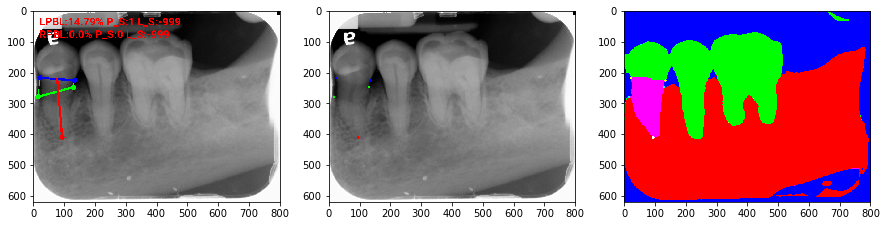

 90%|████████▉ | 427/477 [00:15<00:08,  6.08it/s]

NN_190923_112412_4B152
This case is model can predict but human can not.


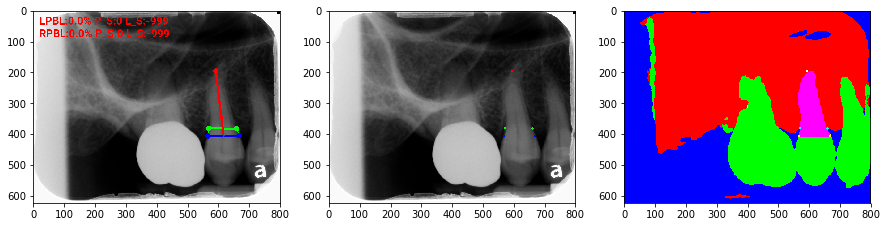

 90%|████████▉ | 429/477 [00:16<00:08,  5.47it/s]

NN_190923_112423_4B14A
This case is model can predict but human can not.


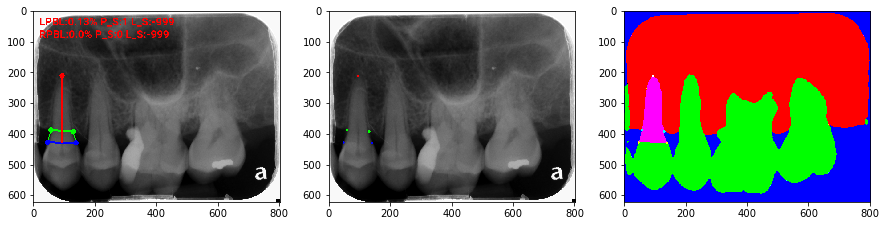

 90%|█████████ | 430/477 [00:16<00:11,  4.08it/s]

NN_190923_112423_4B14A
This case is model can predict but human can not.


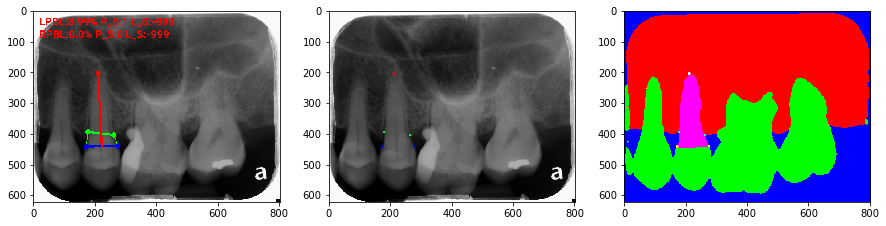

 91%|█████████ | 432/477 [00:17<00:10,  4.27it/s]

NN_190923_112436_4B145
This case is model can predict but human can not.


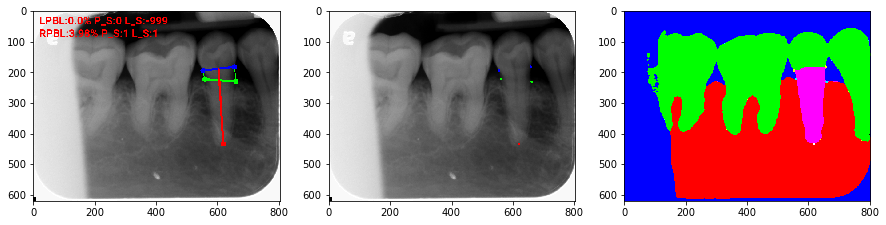

 91%|█████████ | 434/477 [00:17<00:10,  4.14it/s]

NN__191111_145337_24208
This case is model can predict but human can not.


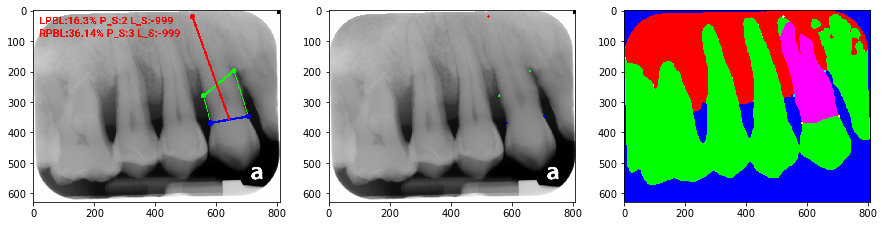

 96%|█████████▋| 460/477 [00:18<00:02,  5.75it/s]

NN__191111_145403_2420D
This case is model can predict but human can not.


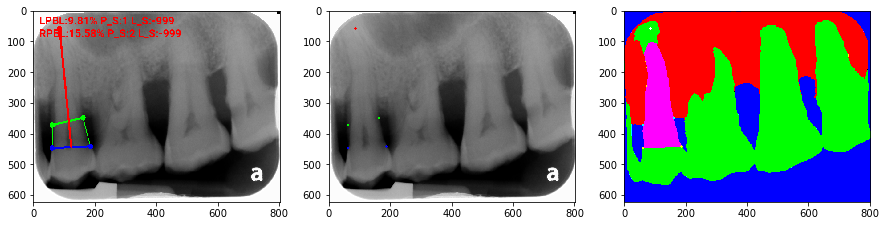

100%|██████████| 477/477 [00:18<00:00, 25.82it/s]


In [13]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_o_image'
seg_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_seg_image'
path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/*.PNG'
image_path_list = glob.glob(path)

count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    if image_name[-2:-1] == '2':
        o_image_name = image_name[:-8]
        print(o_image_name)
        print('This case is model can predict but human can not.')
        #print(image_path.replace('6_result_with_label','4_seg_img_with_cej')[:-10]+'.PNG')
        o_image_path = os.path.join(o_img_folder,o_image_name)
        seg_image_path = os.path.join(seg_img_folder,o_image_name)
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_o_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_seg_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass


In [14]:
print(count)

43


  0%|          | 0/477 [00:00<?, ?it/s]

NN_090903_154118_C07489
This case one PBL = -888.


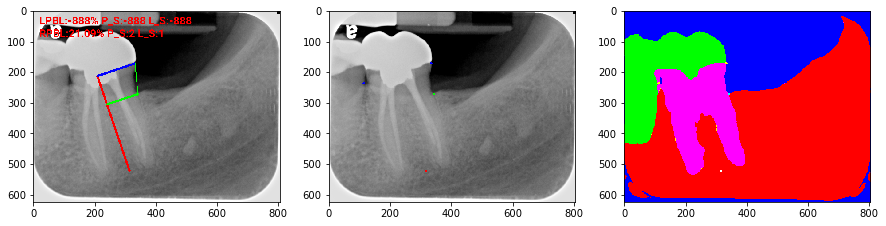

  6%|▌         | 28/477 [00:00<00:06, 70.18it/s]

NN_130821_102800_C057B4
This case one PBL = -888.


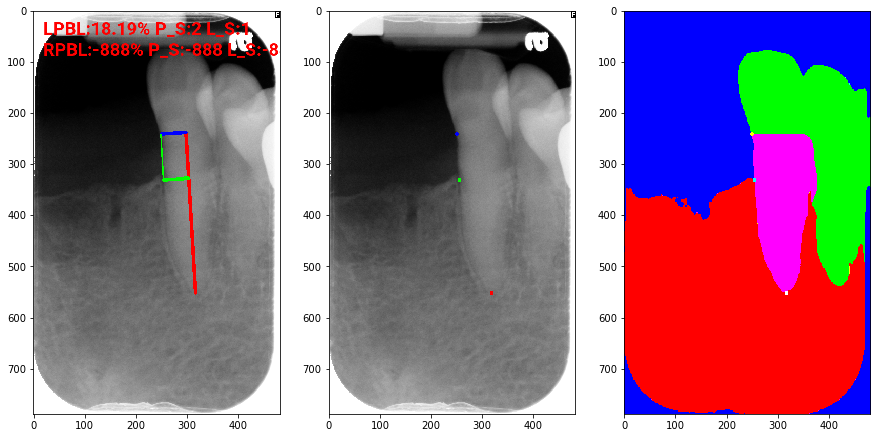

 17%|█▋        | 82/477 [00:00<00:04, 79.87it/s]

NN_160212_152919_9C3C73
This case one PBL = -888.


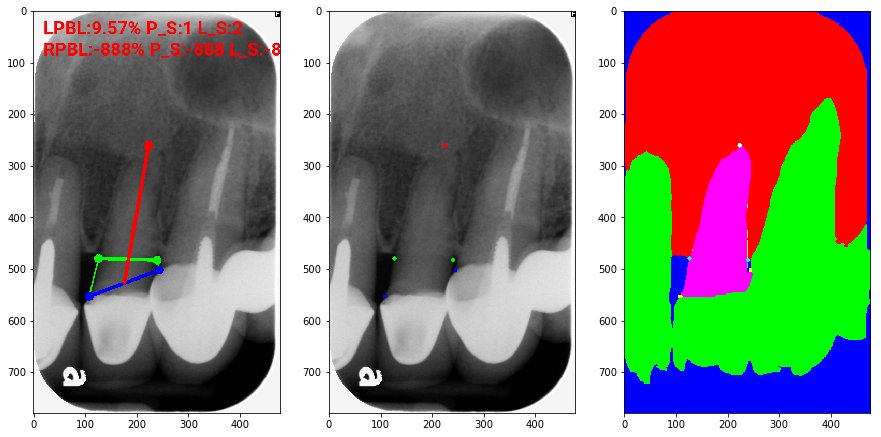

 27%|██▋       | 129/477 [00:01<00:04, 86.81it/s]

NN_160217_094541_16D98D
This case one PBL = -888.


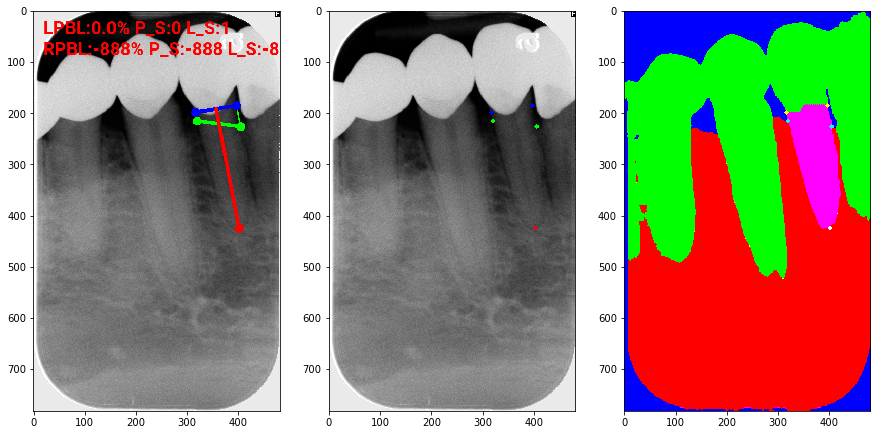

 33%|███▎      | 157/477 [00:01<00:04, 75.92it/s]

NN_170328_100622_9CADDE
This case one PBL = -888.


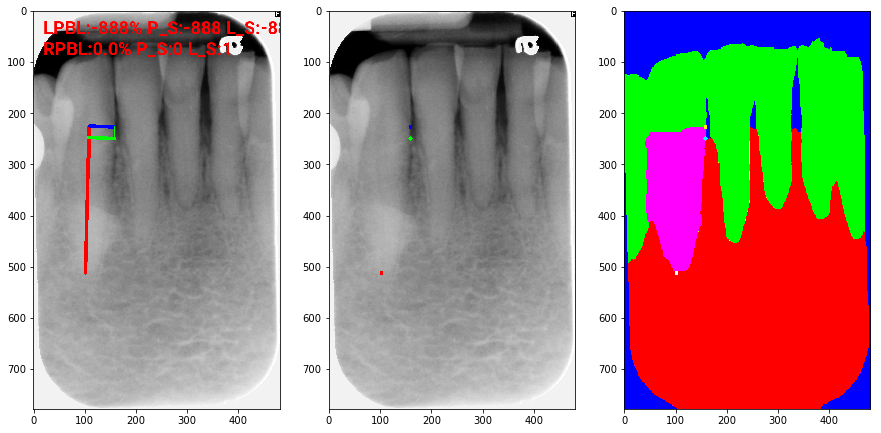

 54%|█████▍    | 259/477 [00:02<00:02, 93.15it/s]

NN_170328_100622_9CADDE
This case one PBL = -888.


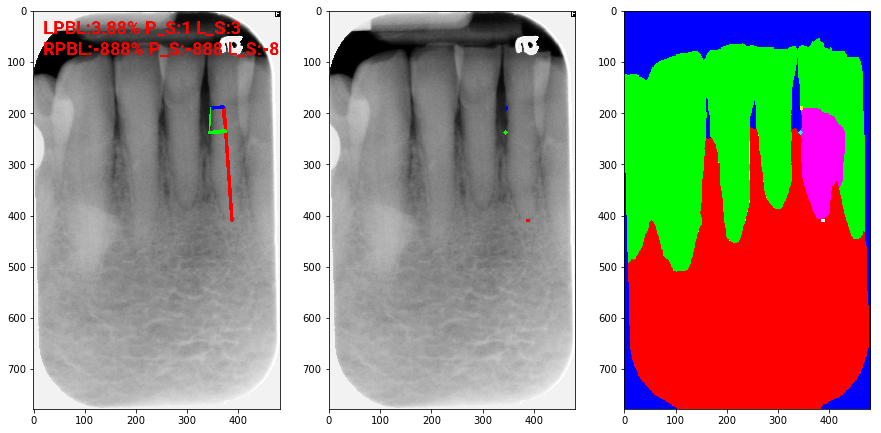

 57%|█████▋    | 270/477 [00:02<00:04, 49.25it/s]

NN_180719_084926_16F371
This case one PBL = -888.


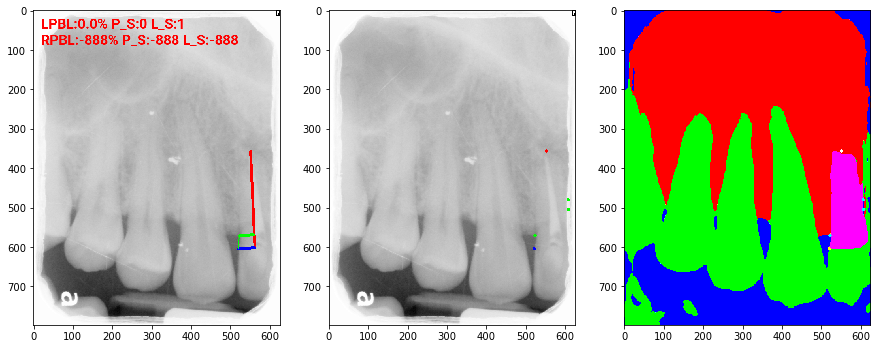

 81%|████████  | 384/477 [00:03<00:01, 64.65it/s]

NN__191111_145309_24203
This case one PBL = -888.


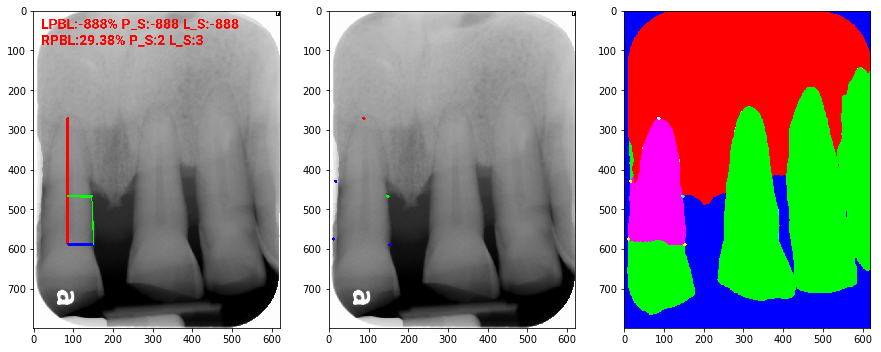

 94%|█████████▎| 447/477 [00:03<00:00, 78.30it/s]

NN__191111_145309_24203
This case one PBL = -888.


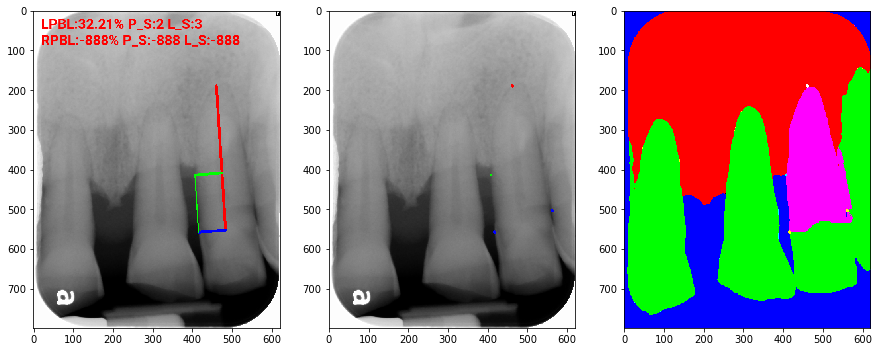

100%|██████████| 477/477 [00:04<00:00, 114.70it/s]


In [15]:
#Show the difference between the prediction and the doctor's judgment
o_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_o_image'
seg_img_folder = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/1_seg_image'
path = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/*.PNG'
image_path_list = glob.glob(path)

count = 0
for index,image_path in tqdm(enumerate(image_path_list),total=len(image_path_list)):
    image_name = get_name_from_path(image_path,False)
    if image_name[-2:-1] == '3':
        o_image_name = image_name[:-8]
        print(o_image_name)
        print('This case one PBL = -888.')
        #print(image_path.replace('6_result_with_label','4_seg_img_with_cej')[:-10]+'.PNG')
        o_image_path = os.path.join(o_img_folder,o_image_name)
        seg_image_path = os.path.join(seg_img_folder,o_image_name)
        plt.figure(figsize=(15,15))
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
        plt.subplot(132)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_o_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(cv2.imread(image_path[:-10].replace('6_result_with_label','5_draw_all_points_on_seg_img')+'.PNG'), cv2.COLOR_BGR2RGB))
        plt.show()
        count +=1
    else:
        pass


In [16]:
print(count)

9


In [17]:
abc = []

for i in abc:
    print(i)

In [18]:
_4_ = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/4_seg_img_with_cej/*.PNG'
_5_ = os_sys+'tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/5_pattern_detection_result/*.PNG'

_4list = glob.glob(_4_)
_5list = glob.glob(_5_)

_4_name_list = [get_name_from_path(path,True) for path in _4list]
_5_name_list = [get_name_from_path(path,True) for path in _5list]


for name in _4_name_list:
    if name not in _5_name_list:
        print(name)

NN_151111_112125_C0ADD7_2.PNG
NN_161012_105949_C03836_3.PNG


In [19]:
# import numpy as np
# import matplotlib.pyplot as plt
# import scipy
# #import skimage.filter

# img_path = '/root/notebooks/tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/3_fill_up_tooth_by_root/NN_151111_112125_C0ADD7_2.PNG'

# img = scipy.misc.imread(img_path, flatten=1)

# #img = np.where(img < 125,255,0)
# y, x = np.nonzero(img)

# ###turn the center of object of nonzero area to [0,0]
# x = x - np.mean(x)
# y = y - np.mean(y)


# ###水平疊加
# coords = np.vstack([x, y])

# ###斜方差
# cov = np.cov(coords)


# evals, evecs = np.linalg.eig(cov)
# sort_indices = np.argsort(evals)[::-1]

# x_v1, y_v1 = evecs[:, sort_indices[0]]  # Eigenvector with largest eigenvalue
# x_v2, y_v2 = evecs[:, sort_indices[1]]

# scale = 200
# plt.plot([x_v1*-scale*2, x_v1*scale*2],
#          [y_v1*-scale*2, y_v1*scale*2], color='red')
# plt.plot([x_v2*-scale, x_v2*scale],
#           [y_v2*-scale, y_v2*scale], color='blue')
# plt.plot(x, y, 'k.')
# plt.axis('equal')
# plt.gca().invert_yaxis()  # Match the image system with origin at top left
# plt.show()

# print(slope(-x_v1,-y_v1,x_v1,y_v1))

In [20]:
fill_up_img = cv2.imread('/root/notebooks/tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/2_roots_unet_mask_components/NN_090903_154047_C07485_3.PNG',0)
value = 0
root_x, root_y,line_of_inertia = root_point_detect(fill_up_img,value)

In [21]:
print(root_x, root_y,line_of_inertia)

[662] [492] [(1151, 1133), (-57, -459)]


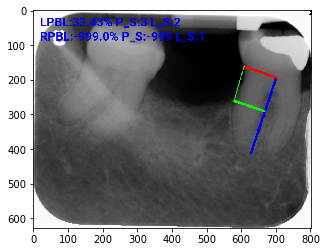

In [22]:
img = cv2.imread('/root/notebooks/tooth_project/tooth_PBL_detection/Pattern_detection/roots_point_detect/6_result_with_label/NN_130821_101512_C057C4_1_err12.PNG')
plt.imshow(img)
plt.show()

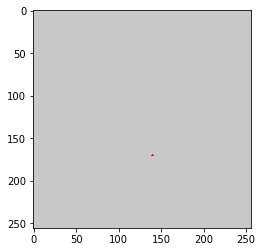

In [23]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

img = np.zeros((256, 256, 3), np.uint8)
img.fill(200)

# cv2.line(img, (0, 0), (255, 255), (0, 0, 255), 5)
# cv2.rectangle(img, (20, 60), (120, 160), (0, 255, 0), 2)
# cv2.rectangle(img, (40, 80), (100, 140), (0, 255, 0), -1)

# # 黃色圓圈，線條寬度為 3 px
# cv2.circle(img,(90, 210), 30, (0, 255, 255), 3)

# 藍色實心圓圈
cv2.circle(img,(140, 170), 1, (255, 0, 0), -1)

#cv2.imshow('My Image', img)
plt.imshow(img)
plt.show()